# Bias-Aware Clustering
In this notebook, we experiment with the Bias-Aware Clustering algorithm to identify which of the clustering algorithms (K-Means, DBSCAN or MeanShift) perform best in identifying discriminated clusters. The experiment is conducted on a synthetic dataset. The process of creating this dataset can be found in the "synthetic data" notebook. 

### Init


In [1]:
# Loading the libraries
import numpy as np 
import matplotlib.pyplot as plt
# plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
import pandas as pd
import seaborn as sns
import random
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from scipy import stats
import scipy.stats as stats
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
import warnings
warnings.filterwarnings('ignore')

## 1. Importing the Dataset

In [22]:
#original theoretical dataset
# raw_data = pd.read_csv(r'..\Preprocessed_datasets\synt1_final.csv', index_col=0)
# raw_data.index = pd.RangeIndex(start=0, stop=2110, step=1)

raw_data = pd.read_csv(r'..\Preprocessed_datasets\synt2_final.csv', index_col=0)

# errors
display(len(raw_data.loc[raw_data['errors']==1]))
display(len(raw_data.loc[raw_data['errors']==0]))

raw_data.info()

953

1397

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2350 entries, 0 to 249
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Feature 1  2350 non-null   float64
 1   Feature 2  2350 non-null   float64
 2   errors     2350 non-null   int64  
 3   class      2350 non-null   int64  
dtypes: float64(2), int64(2)
memory usage: 91.8 KB


In [ ]:
scatterplot = sns.scatterplot(data=df, x='x', y='y', alpha=0.8, hue="class", size='errors', sizes=(100, 20), palette="tab10")
scatterplot.set_title('Synthetic Dataset with 4 Clusters and Uniformly Distributed Errors', size=17)
plt.show()  

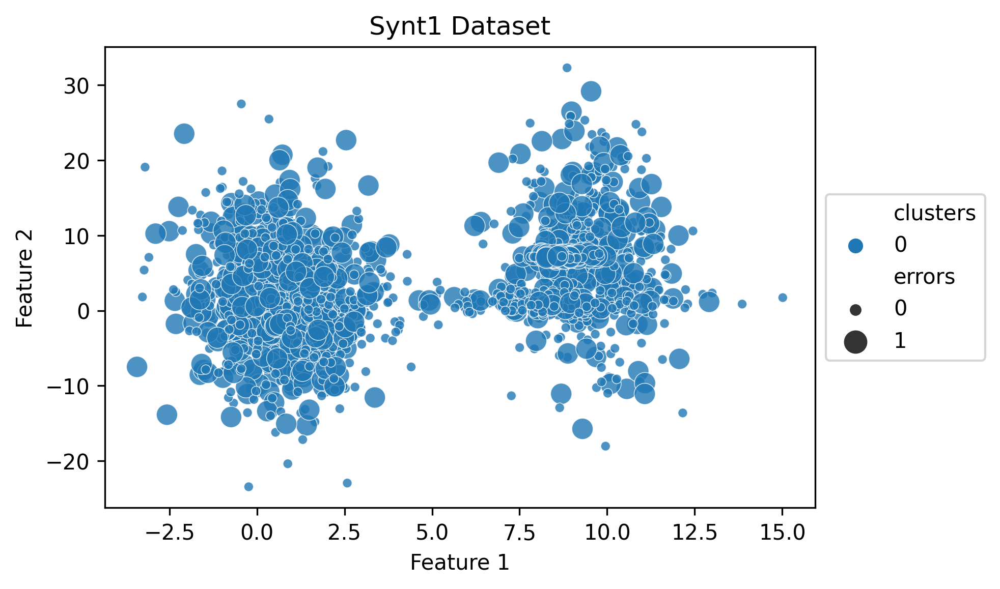

In [15]:
full_data = initialize_synthetic_data(raw_data)
plot_clusters(full_data)




### Utils

In [12]:
def initialize_synthetic_data(raw_data, with_errors=True):
    """Initialisation of the theoretical dataset. Scales all the features and can also scale the errors, which can be included or excluded for clustering 
    It returns a scaled dataset with new columns "clusters" = 0 and "new_clusters" = -1, which are required for HBAC """

    new_data = raw_data.copy(deep=True)

    if with_errors:
        scaling_factor = 0.8 #needs to be converted to scaling range [0.2 - 1.2]
        new_data['scaled_errors'] = new_data['errors'] * 0.8

    #if just_features:
    #    new_data = new_data.drop(['errors', 'class'], axis=1)

    #if scale_features:
    #    to_scale = raw_data.drop(['errors', 'class'], axis=1).columns
    #    new_data[to_scale] = StandardScaler().fit_transform(features[to_scale])
    
    #if with_classes:
    #    for col in ['errors']:
    #        new_data[col] = raw_data[col]

    new_data['clusters'] = 0
    new_data['new_clusters'] = -1
    return new_data

def plot_clusters(data):
    """This function returns a scatterplot of the clusters"""
    data.rename(columns={'x' :'Feature 1'}, inplace=True )
    data.rename(columns={'y':'Feature 2'}, inplace=True )
    # scatterplot = sns.scatterplot(data=data, x='x', y='y', alpha=0.8, hue="clusters", size='errors', sizes=(100, 20), palette="tab10")
    scatterplot = sns.scatterplot(data=data, x='Feature 1', y='Feature 2', alpha=0.8, hue="clusters", size='errors', sizes=(100, 20), palette="tab10")
    scatterplot.set_title('Synt1 Dataset')
    scatterplot.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    plt.show()

In [111]:
# def pca_plot(data):
#     pca_features = data.drop(['scaled_errors', 'predicted_class', 'true_class', 'errors', 'clusters', 'new_clusters'], axis=1)
#     other_features = data[['scaled_errors', 'predicted_class', 'true_class', 'errors', 'clusters', 'new_clusters']]

#     df = pd.DataFrame(pca_features)
#     pca = pd.DataFrame(PCA(n_components=2).fit_transform(df), index=df.index)

#     temp_dataset = pca.join(other_features, how='left')
#     temp_dataset.rename( columns={0 :'1st'}, inplace=True )
#     temp_dataset.rename( columns={1 :'2nd'}, inplace=True )
    
#     scatterplot = sns.scatterplot(data=temp_dataset, x='1st', y='2nd', hue="clusters", size='errors', sizes=(100, 20), palette="tab10")
#     scatterplot.set_title('test')
#     plt.show()

def initialize_dataset(raw_data, with_errors=True, just_features=True, scale_features=True, with_classes=True):
    """Initialisation of the dataset. Scales all the features and can also scale the errors, which can be included or excluded for clustering 
    It returns a scaled dataset with new columns "clusters" = 0 and "new_clusters" = -1, which are required for HBAC """

    new_data = raw_data.copy(deep=True)

    if with_errors:
        scaling_factor = 0.8 #needs to be converted to scaling range [0.2 - 1.2]
        new_data['scaled_errors'] = new_data['errors'] * 0.8

    if just_features:
        new_data = new_data.drop(['errors', 'class'], axis=1)

    if scale_features:
        to_scale = raw_data.drop(['errors', 'class'], axis=1).columns
        new_data[to_scale] = StandardScaler().fit_transform(features[to_scale])
    
    if with_classes:
        for col in ['errors']:
            new_data[col] = raw_data[col]

    new_data['clusters'] = 0
    new_data['new_clusters'] = -1
    return new_data

def get_random_cluster(clusters):
    """This function returns the value of a random cluster
    clusters Df.Column the column clusters"""
    result = -1
    while (result == -1):
        result = random.randint(0, len(clusters.unique()))
    return result

def plot_clusters(data):
    """This function returns a scatterplot of the clusters"""    
    scatterplot = sns.scatterplot(data=data, x='x', y='y', hue="clusters", size='errors', sizes=(100, 20), palette="tab10")
    plt.show()

def accuracy(results):
    """This function calculates the accuracy of a DF dataframe
    It requires a df.column named "errors" """ 
    if len(results) == 0:
        print("You are calculating the accuracy on a empty cluster") 
    correct = results.loc[results['errors'] == 0]
    acc = len(correct)/len(results)
    return acc

def bias_acc(data, cluster_id, cluster_col):
    """ This function calculates the negative bias, which is the accuracy of the selected cluster - the accuracy of the remaining clusters 
    Cluster col: the name of the DF column where the cluster assignments are """
    cluster_x = data.loc[data[cluster_col] == cluster_id]
    if len(cluster_x) ==0:
        print("This is an empty cluster! cluster ", cluster_id)
    remaining_clusters = data.loc[data[cluster_col] != cluster_id]
    if len(remaining_clusters) == 0:
        print("This cluster is the entire dataset. cluster ", cluster_id)
    return accuracy(cluster_x) - accuracy(remaining_clusters)

def bias_acc_towards_global_average(data, cluster_id, cluster_col, ave_acc):
    """ This function calculates the negative bias, which is the accuracy of the selected cluster - the average accuracy
    Cluster col: the name of the DF column where the cluster assignments are """
    cluster_x = data.loc[data[cluster_col] == cluster_id]
    return accuracy(cluster_x) - ave_acc

def get_next_cluster(data):
    """ This function returns the cluster number with the highest variance. The variance is calculated based on the errors of each cluster.
    The cluster with the highest variance will be selected as splitting cluster
    The function requires df.columns named "clusters" and "errors" """
    n_cluster = max(data['clusters'])
    highest_variance = -1
    cluster_number = 0

    for i in data['clusters'].unique():
        if (i == -1):
            continue
        cluster_i = data.loc[data['clusters'] == i]
        variance_cluster = np.var(cluster_i['errors'])
        
        if variance_cluster > highest_variance:
            highest_variance = variance_cluster
            cluster_number = i
            print('--> Cluster with the highest variance:', cluster_number)

    return cluster_number

def get_max_abs_bias(fulldata, function=bias_acc):
    """ This function returns the absolute value of highest negative bias of the newly introduced clusters 
    fulldata (DataFrame) should include a column new_clusters """
    max_abs_bias = -999999
    for cluster_number in fulldata['new_clusters'].unique():
        if cluster_number == -1: #Outliers in DBScan
            continue
        current_bias = abs(function(fulldata, cluster_number, "new_clusters")) # abs function
        if current_bias > max_abs_bias:
            max_abs_bias = current_bias
    return max_abs_bias

def get_max_negative_bias(fulldata, function=bias_acc):
    """ This function returns the highest negative bias of the newly introduced clusters 
    fulldata (DataFrame) should include a column new_clusters  --> used for identifying underperformed clusters"""
    max_abs_bias = -999999
    for cluster_number in fulldata['new_clusters'].unique():
        if cluster_number == -1: #Outliers in DBScan
            continue
        current_bias = (function(fulldata, cluster_number, "new_clusters")) # abs function
        if current_bias < max_abs_bias:
            print('current bias: ', current_bias)
            print('max abs bias: ', max_abs_bias)
            max_abs_bias = current_bias
    return max_abs_bias

def get_max_bias_cluster(fulldata, function=bias_acc):
    """ This function returns the cluster linked to the highest negative bias of the newly introduced clusters 
    fulldata (DataFrame) should include a column new_clusters """
    max_abs_bias = 100
    best_cluster = -2
    for cluster_number in fulldata['clusters'].unique():
        if cluster_number == -1: #Outliers in DBScan
            continue
        current_bias = function(fulldata, cluster_number, "clusters") # abs function
        print(f"{cluster_number} has bias {current_bias}")
        if current_bias < max_abs_bias:
            max_abs_bias = current_bias
            best_cluster = cluster_number
    return best_cluster

def calculate_variance(data):
    """This function calculates the variance for a DF. It requires a df.column named "clusters" and it uses the bias_acc_towards_global_avg"""
    variance_list_local = []
    for j in data['clusters'].unique():
        average_accuracy = accuracy(data)
        neg_bias_clus = bias_acc(data, j, 'clusters') 
        variance_list_local.append(neg_bias_clus) #variance_list was "neg_bias_list" before
    variance = np.var(variance_list_local) #this was "neg_bias_list"
    return variance

def get_min_cluster_size(data):
    """Returns the size of the smallest new cluster"""
    min_cluster_size = len(data)
    for i in data['new_clusters'].unique():
        # exclude the cluster -1 from being seen as a cluster, since it contains outliers
        if i == -1:
            continue
        size = len(full_data.loc[full_data['new_clusters']==i])
        if size < min_cluster_size:
            min_cluster_size = size
    return min_cluster_size

# 1. Bias-Aware KMeans Clustering 

In [113]:
clus_model_kwargs = {
    "n_clusters": 2,
    "init": "k-means++",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 2,
}

In [118]:
full_data = initialize_synthetic_data(raw_data)
# full_data.index = pd.RangeIndex(start=0, stop=4032, step=1)
full_data.index = pd.RangeIndex(start=0, stop=1788, step=1)
full_data.head()


,x,y,errors,class,scaled_errors,clusters,new_clusters
0,9.380904,17.480874,0,0,0.0,0,-1
1,9.909902,22.482784,0,0,0.0,0,-1
2,11.263224,5.092047,0,0,0.0,0,-1
3,8.551899,7.740662,1,0,0.8,0,-1
4,7.370218,4.533171,1,0,0.8,0,-1


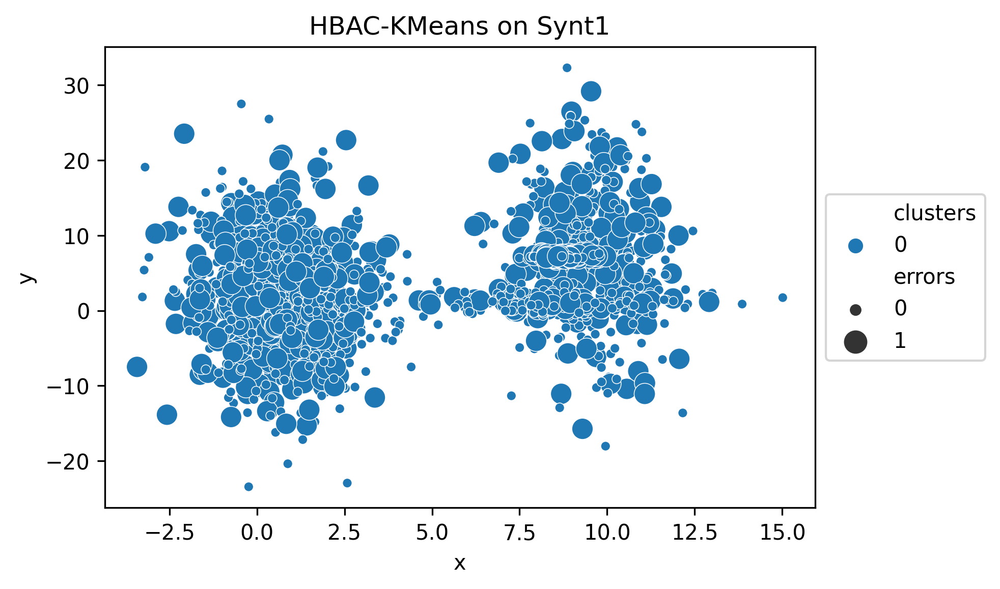

average_accuracy is:  0.6655480984340044


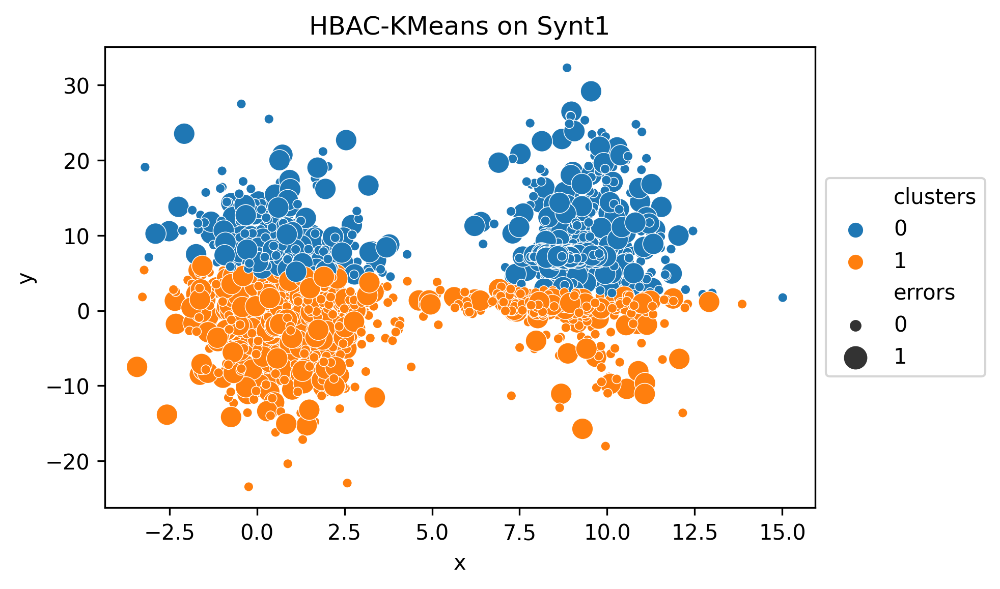

--> Cluster with the highest variance: 0


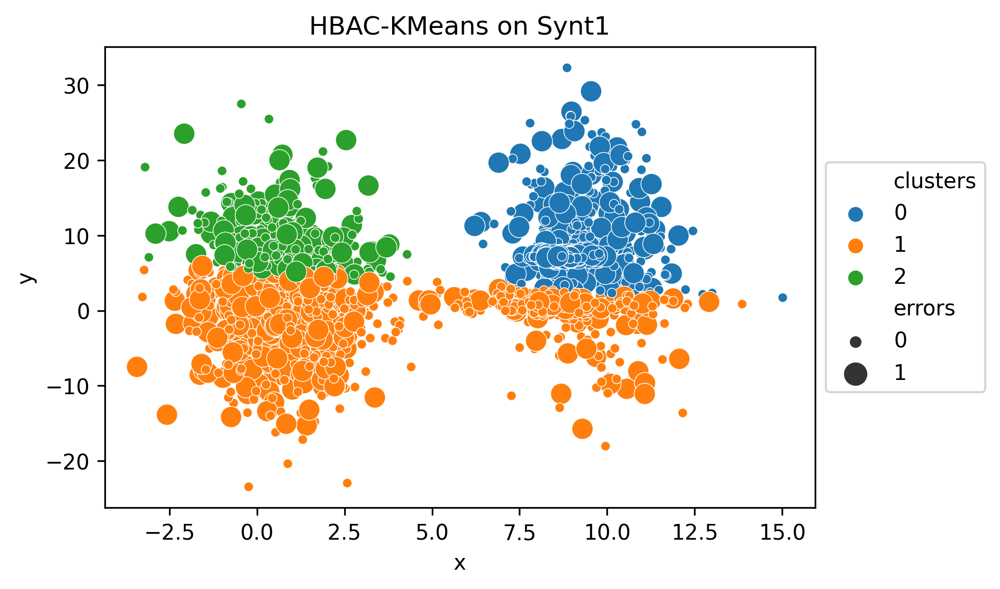

--> Cluster with the highest variance: 0
--> Cluster with the highest variance: 2


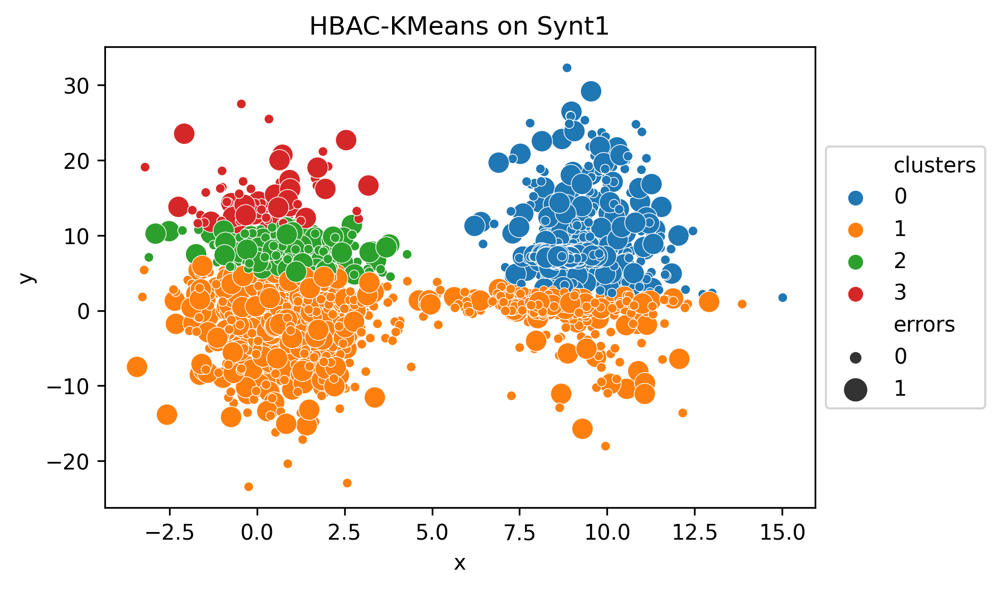

--> Cluster with the highest variance: 0
--> Cluster with the highest variance: 2


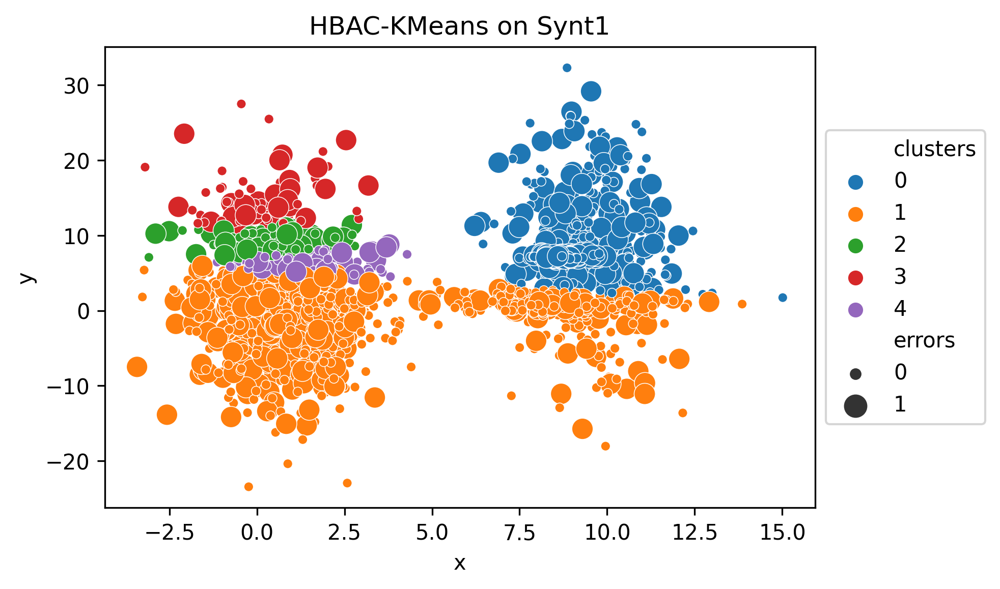

--> Cluster with the highest variance: 0
--> Cluster with the highest variance: 2


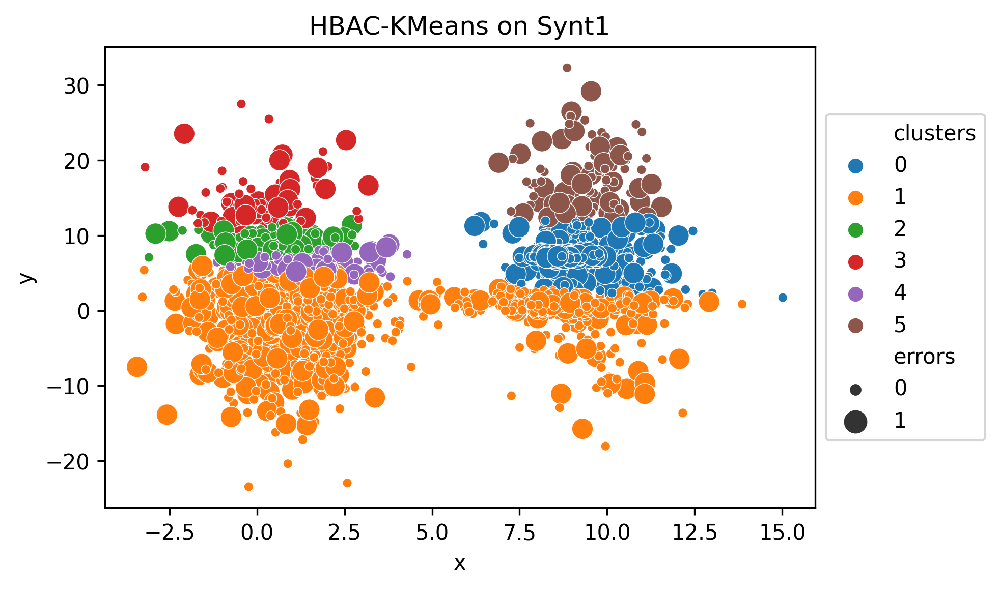

--> Cluster with the highest variance: 5
--> Cluster with the highest variance: 2


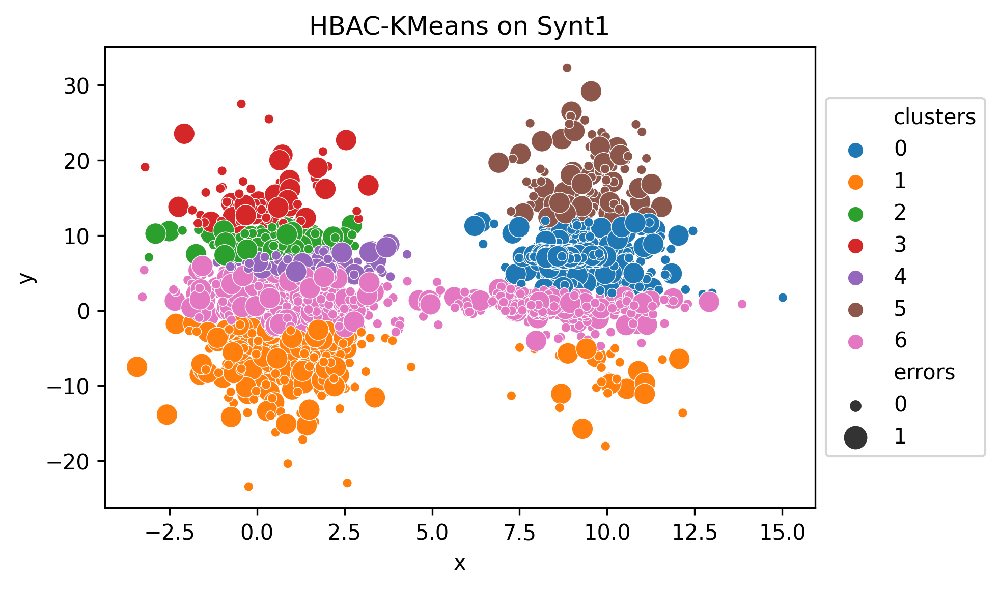

--> Cluster with the highest variance: 5
--> Cluster with the highest variance: 2


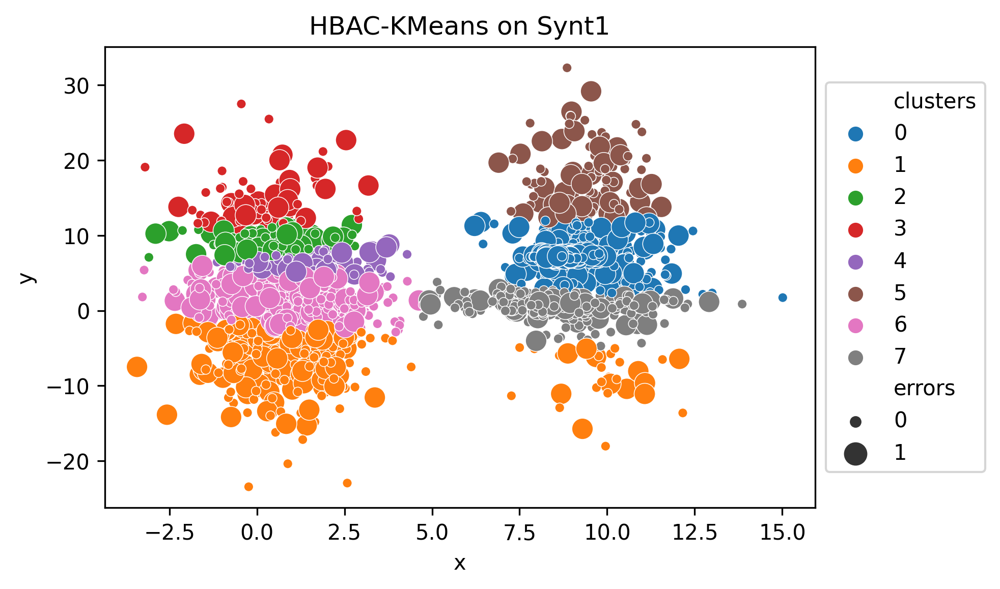

--> Cluster with the highest variance: 5
--> Cluster with the highest variance: 2


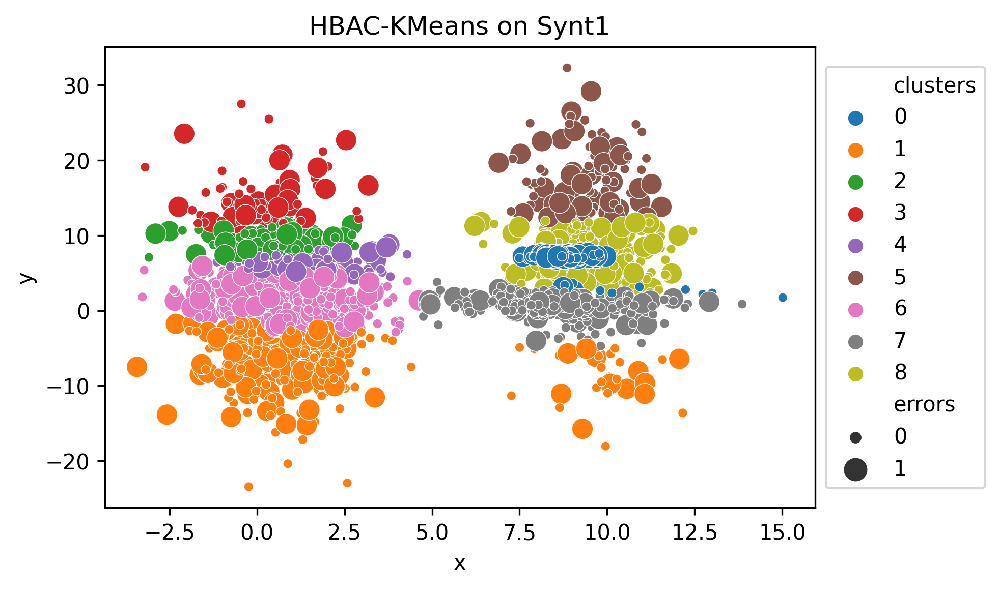

--> Cluster with the highest variance: 5
--> Cluster with the highest variance: 8
--> Cluster with the highest variance: 2


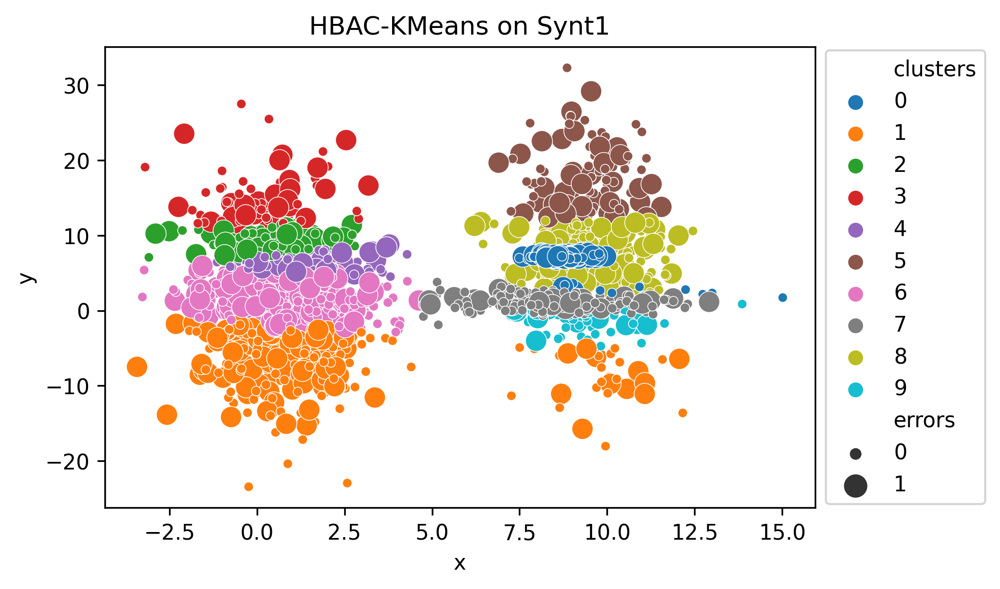

--> Cluster with the highest variance: 5
--> Cluster with the highest variance: 8
--> Cluster with the highest variance: 2
MAX_ITER is reached
[0.0027438910995207714, 0.002002788570932189, 0.0016682438284861339, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.0021246451568740212, 0.002110065550743406, 0.002110065550743406, 0.002110065550743406, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.002220603363131385, 0.004517719263017928, 0.004517719263017928, 0.004695373955564802, 0.004695373955564802, 0.004695373955564802]


In [119]:
MAX_ITER = 30
x = 0 # cluster number
initial_bias = 0
plot_clusters(full_data)
variance_list = []
average_accuracy = accuracy(full_data) 
minimal_splittable_cluster_size = round(0.05 * len(full_data))
minimal_acceptable_cluster_size = round(0.03 * len(full_data))
print("average_accuracy is: ", average_accuracy) 

for i in range(1, MAX_ITER):
    if i != 1:
        variance_list.append(calculate_variance(full_data)) 
    full_data['new_clusters'] = -1
    candidate_cluster = full_data.loc[full_data['clusters'] == x] 

    if len(candidate_cluster) < minimal_splittable_cluster_size:
        x = get_random_cluster(full_data['clusters'])
        continue
    
    # Apply Kmeans 
    kmeans_algo = KMeans(**clus_model_kwargs).fit(candidate_cluster.drop(['clusters', 'new_clusters', 'errors'], axis=1))
    
    candidate_cluster['new_clusters'] = pd.DataFrame(kmeans_algo.predict(candidate_cluster.drop(['clusters', 'new_clusters', 'errors'], axis=1)),index=candidate_cluster.index) 
    full_data['new_clusters'] = candidate_cluster['new_clusters'].combine_first(full_data['new_clusters'])

    max_neg_bias = get_max_negative_bias(full_data) # was get_max_abs_bias, but now it only finds the discriminated clusters
    min_new_size = get_min_cluster_size(full_data)
    
    if (max_neg_bias <= initial_bias) & (min_new_size > minimal_acceptable_cluster_size): #abs: >
        # Add new cluster
        n_cluster = max(full_data['clusters'])
        full_data['clusters'][full_data['new_clusters'] == 1] =  n_cluster + 1
        
        plot_clusters(full_data)
        x = get_next_cluster(full_data)
        initial_bias = max_neg_bias
    else:
        x = get_random_cluster(full_data['clusters'])
        
print('MAX_ITER is reached')
print(variance_list)


### 1. Analysing the clustering results


In [120]:
# Goal 1: Identifying highest biased cluster
c = get_max_bias_cluster(full_data)
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
most_biased_cluster_kmeans_aware = bias_acc(full_data, c, 'clusters')
full_data[full_data['clusters']==c]

print('General accuracy of classifier on this dataset:', accuracy_full_data)
# print('Number of clusters: ', full_data['clusters'].unique()) 
print(f"cluster {c} has the highest negative bias")
print(most_biased_cluster_kmeans_aware)

5 has bias -0.06984505363528015
8 has bias -0.07583851815441933
1 has bias -0.018847089269624417
9 has bias 0.03735948446643944
7 has bias 0.1893839228677967
6 has bias -0.01057069679821765
2 has bias -0.09045454545454545
3 has bias -0.03848328621320474
4 has bias -0.012806141313597807
0 has bias 0.033904324782121686
General accuracy of classifier on this dataset: 0.6655480984340044
cluster 2 has the highest negative bias
-0.09045454545454545


Text(0.5, 1.0, 'Variance of Instances during Iterations')

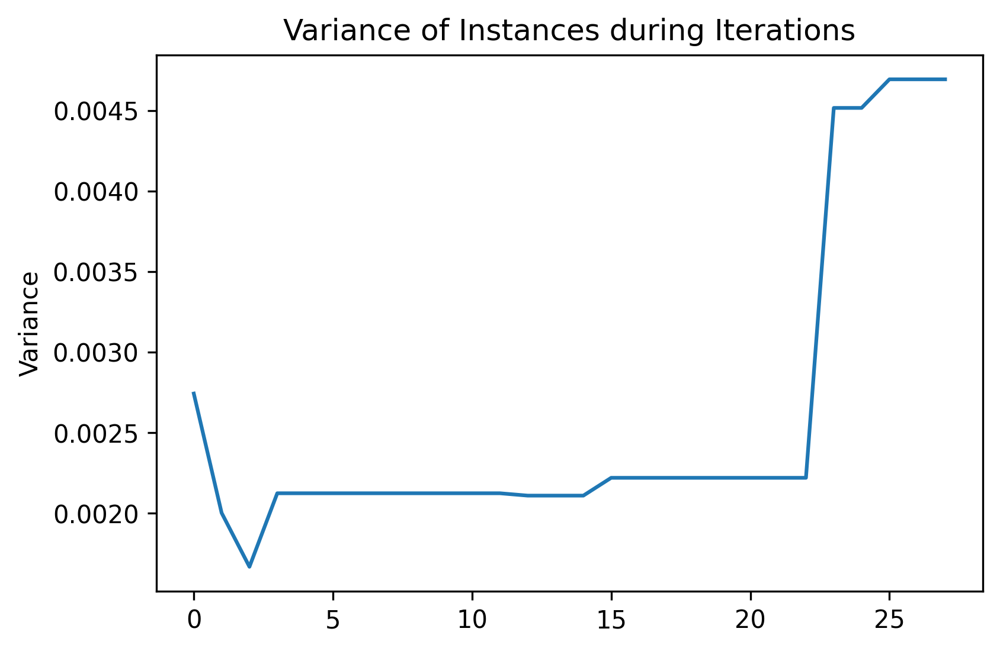

In [122]:
variance_df_kmeans = pd.DataFrame(variance_list).rename(columns={0:"Variance"})
sns.lineplot(data=variance_df_kmeans, x=variance_df_kmeans.index,y="Variance").set_title('Variance of Instances during Iterations')


In [123]:
discriminated_cluster = full_data[full_data['clusters']==c]
print('Number of instances in discriminated cluster:', len(discriminated_cluster))
print('Number of errors in discriminated clusters: ', len(discriminated_cluster.loc[discriminated_cluster['errors']==1]))
discriminated_cluster

Number of instances in discriminated cluster: 88
Number of errors in discriminated clusters:  37


,x,y,errors,class,scaled_errors,clusters,new_clusters
416,2.207359,8.764132,0,1,0.0,2,-1.0
425,0.009946,10.660639,0,1,0.0,2,-1.0
429,-0.787870,9.815693,0,1,0.0,2,-1.0
433,-0.477172,8.122182,0,1,0.0,2,-1.0
439,0.100423,8.569307,0,1,0.0,2,-1.0
...,...,...,...,...,...,...,...
1223,1.474397,8.166082,0,2,0.0,2,-1.0
1226,0.478115,8.597642,0,2,0.0,2,-1.0
1229,0.433168,11.045898,0,2,0.0,2,-1.0
1290,0.853379,10.121955,1,2,0.8,2,-1.0


In [126]:
not_discriminated = full_data[full_data['clusters']!=c]
not_discriminated.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1700 entries, 0 to 1787
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   x              1700 non-null   float64
 1   y              1700 non-null   float64
 2   errors         1700 non-null   int64  
 3   class          1700 non-null   int64  
 4   scaled_errors  1700 non-null   float64
 5   clusters       1700 non-null   int64  
 6   new_clusters   1700 non-null   float64
dtypes: float64(4), int64(3)
memory usage: 106.2 KB


In [144]:
# unscaling the discriminated cluster
discriminated = raw_data.loc[discriminated_cluster.index, :]

# unscaled other data
remaining = raw_data.drop(discriminated_cluster.index)

In [145]:
for i in remaining:
    welch_i = stats.ttest_ind(discriminated[i], remaining[i], equal_var=False)
    print(i)
    print('this is the p-value:', welch_i.pvalue)

x
this is the p-value: 1.9659718078397745e-78
y
this is the p-value: 1.1194966780913276e-114
errors
this is the p-value: 0.09804331411856856
class
this is the p-value: 1.8917728915334998e-13


In [146]:
research_km = pd.DataFrame()
research_km['discriminated'] = discriminated.mean()
research_km['remaining'] = remaining.mean()
research_km['difference'] = discriminated.mean() - remaining.mean()

research_km

,discriminated,remaining,difference
x,0.266740,5.103428,-4.836688
y,9.155414,3.413739,5.741675
errors,0.420455,0.330000,0.090455
class,1.227273,1.668824,-0.441551


## Ridge Plot 

In [129]:
from ridgeplot import ridgeplot

not_discriminated = full_data[full_data['clusters']!=c]
df = not_discriminated


# Let's grab only the subset of columns displayed in the example
column_names = [
    "x", "y", "scaled_errors"]
df = df[column_names]

# Not only does 'ridgeplot(...)' come configured with sensible defaults
# but is also fully configurable to your own style and preference!
fig = ridgeplot(
    samples=df.values.T,
    bandwidth=4,
    kde_points=np.linspace(-12.5, 112.5, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 9,
)

# Again, update the figure layout to your liking here
fig.update_layout(
    title="HBAC-KMeans on Synt: Discriminated Cluster distribution",
    height=650,
    width=800,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="Assigned Probability (%)",
)
fig.show()

## Baseline KMeans

In [136]:
full_data = initialize_synthetic_data(raw_data)
full_data.head()

,x,y,errors,class,scaled_errors,clusters,new_clusters
0,9.380904,17.480874,0,0,0.0,0,-1
1,9.909902,22.482784,0,0,0.0,0,-1
2,11.263224,5.092047,0,0,0.0,0,-1
3,8.551899,7.740662,1,0,0.8,0,-1
4,7.370218,4.533171,1,0,0.8,0,-1


In [70]:
# Same number of clusters as the found clusters by the bias-aware clustering algorithm?
baseline_kmeans = KMeans(n_clusters=9, init="k-means++", n_init=10, max_iter=300, random_state=10).fit(full_data.drop(['clusters', 'new_clusters', 'errors'], axis=1))
full_data['clusters'] = pd.DataFrame(baseline_kmeans.predict(full_data.drop(['clusters', 'new_clusters','errors'], axis=1)),index=full_data.index) 


In [71]:
# Goal 1: Identifying highest biased cluster
c = get_max_abs_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_baselinekm = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_baselinekm)

6 has bias -0.08704008300761101
2 has bias -0.06340522954572847
4 has bias -0.14937933126162928
7 has bias 0.08552631578947367
0 has bias 0.060637038283115174
5 has bias 0.26269464889239513
1 has bias 0.32357558940575604
3 has bias -0.8183324130314743
8 has bias 0.02977548821350018
cluster 3 has the highest negative bias
[6 2 4 7 0 5 1 3 8]
Overall accuracy: 0.7351190476190477
Highest found negative bias: -0.8183324130314743


# 2. Bias-Aware DBSCAN

In [72]:
from sklearn.cluster import DBSCAN

In [157]:
full_data = initialize_synthetic_data(raw_data)
# full_data.index = pd.RangeIndex(start=0, stop=4032, step=1)
full_data.index = pd.RangeIndex(start=0, stop=1788, step=1)
full_data.head()

nn_features = full_data[['x', 'y', 'scaled_errors']]
nn_features.head()

,x,y,scaled_errors
0,9.380904,17.480874,0.0
1,9.909902,22.482784,0.0
2,11.263224,5.092047,0.0
3,8.551899,7.740662,0.8
4,7.370218,4.533171,0.8


In [153]:
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN


Text(0.5, 1.0, 'Determining Optimal Value Epsilon for Synt1')

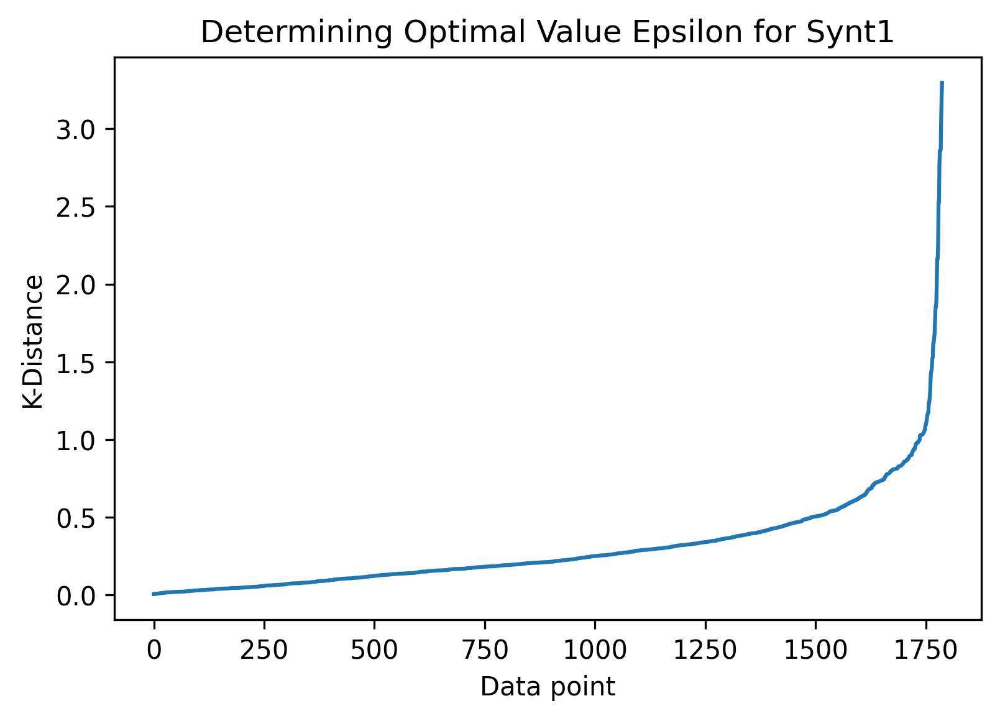

In [156]:
from sklearn.neighbors import NearestNeighbors

neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(nn_features)
distances, indices = nbrs.kneighbors(nn_features)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.xlabel('Data point')
plt.ylabel('K-Distance')
plt.title('Determining Optimal Value Epsilon for Synt1')

In [ ]:
MAX_ITER = 30
epsilon =  3
minimum_samples = 3 # round(0.02 * len(full_data)) # 2*dim?
x = 0 # cluster number
initial_bias = 0
pca_plot(full_data)
variance_list = []
minimal_splittable_cluster_size = round(0.03 * len(full_data))
minimal_acceptable_cluster_size = round(0.01 * len(full_data))
average_accuracy = accuracy(full_data)

for i in range(1, MAX_ITER):
    print('this is the current cluster: ', x)
    epsilon = epsilon - 0.01
    if len(full_data['clusters'].unique()) != 1:
        variance_list.append(calculate_variance(full_data))

    full_data['new_clusters'] = -2
    candidate_cluster = full_data.loc[full_data['clusters'] == x] 

    if len(candidate_cluster) < minimal_splittable_cluster_size:
        x = get_random_cluster(full_data['clusters'])
        continue
    
    # Apply DBSCAN
    candidate_cluster['new_clusters'] = pd.DataFrame(DBSCAN(eps=epsilon, min_samples=minimum_samples).fit_predict(candidate_cluster.drop(['clusters', 'new_clusters', 'predicted_class', 'true_class', 'errors'], axis=1)), index=candidate_cluster.index)

    full_data['new_clusters'] = candidate_cluster['new_clusters'].combine_first(full_data['new_clusters'])
    
    if (len(full_data['new_clusters'].unique()) <= 2): # to check whether a new cluster is found
        continue

    max_neg_bias = get_max_negative_bias(full_data) #get max abs bias
    min_new_size = get_min_cluster_size(full_data)
    print("smallest cluster: ", min_new_size)
    
    if (max_neg_bias <= initial_bias) & (min_new_size > minimal_acceptable_cluster_size): #>
        # Add new cluster
        n_cluster = max(full_data['clusters'])
        # print(full_data['new_clusters'])
        
        first = True
        dif = 1
        for clstr in full_data['new_clusters'].unique():
            if (clstr == -1):
                full_data['clusters'][full_data['new_clusters'] == clstr] = -1
            elif (clstr == -2):
                continue
            elif first:
                full_data['clusters'][full_data['new_clusters'] == clstr] = x
                first = False
            else:
                full_data['clusters'][full_data['new_clusters'] == clstr] =  n_cluster + dif
                dif += 1

        pca_plot(full_data)
        x = get_next_cluster(full_data)
        initial_bias = max_neg_bias
    else:
        x = get_random_cluster(full_data['clusters'])
        
print('MAX_ITER')
print(average_accuracy)
print(variance_list)

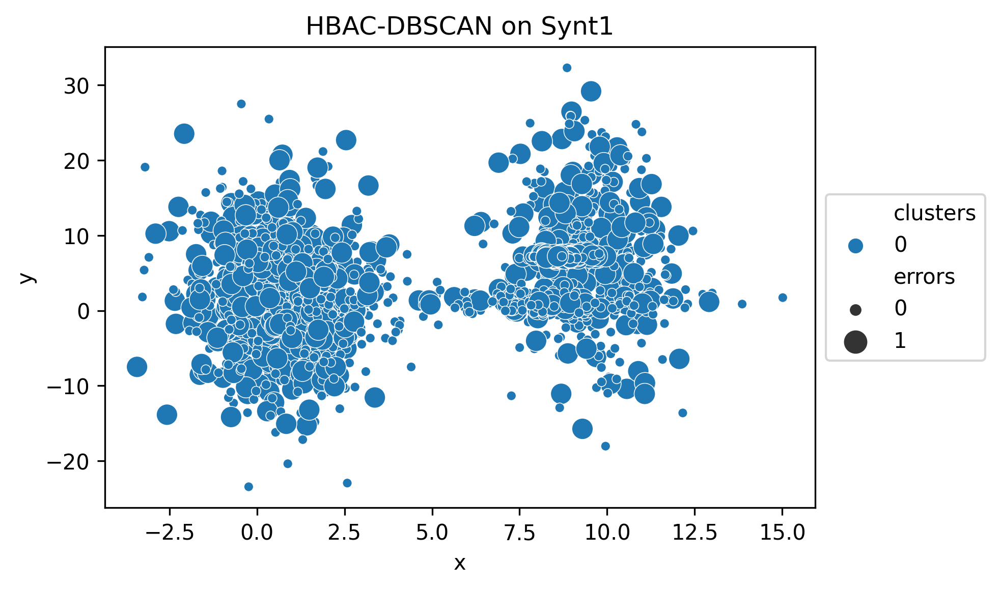

this is the current cluster:  0


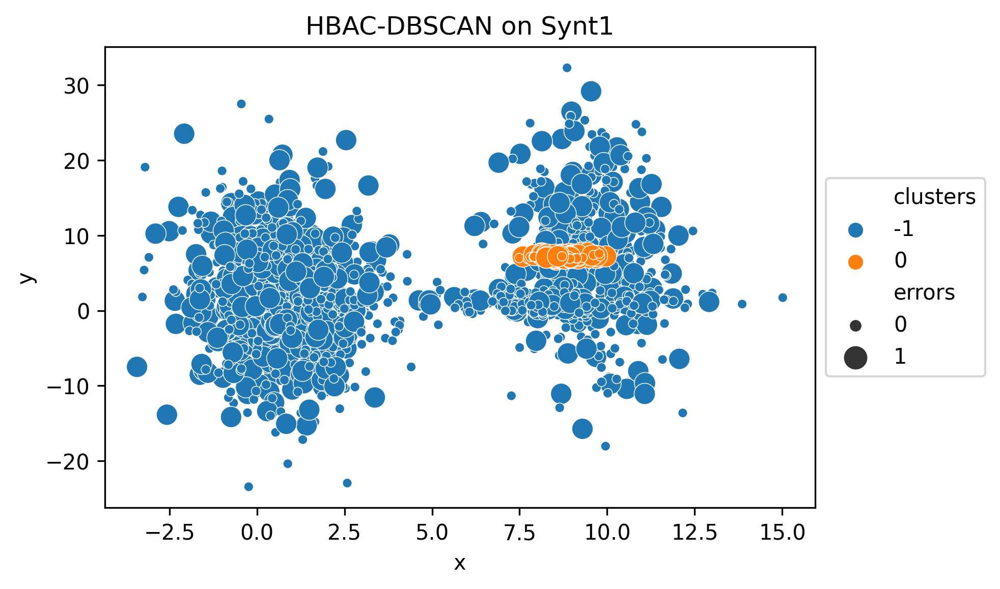

--> Cluster with the highest variance: 0
this is the current cluster:  0


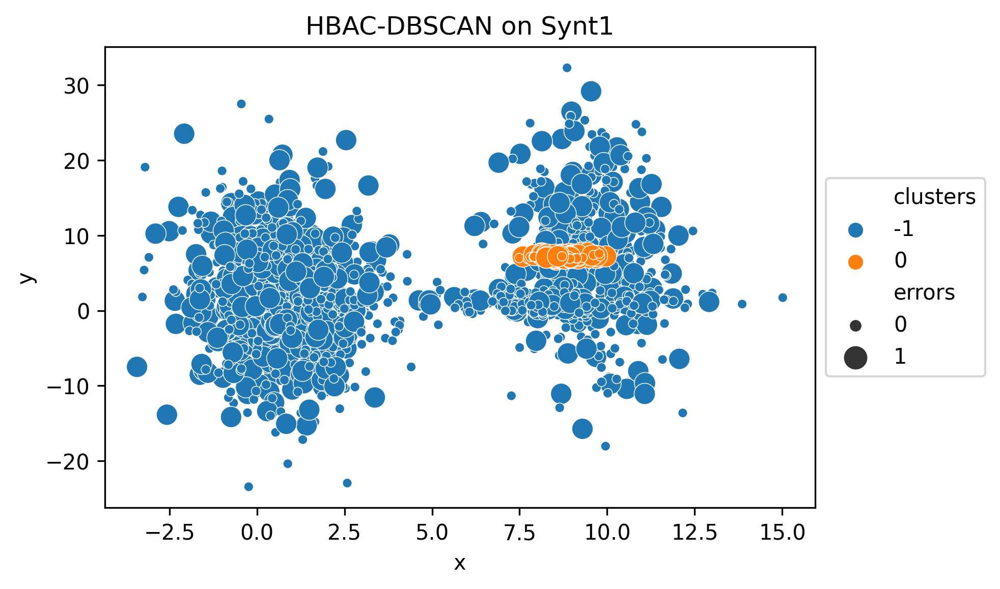

--> Cluster with the highest variance: 0
this is the current cluster:  0


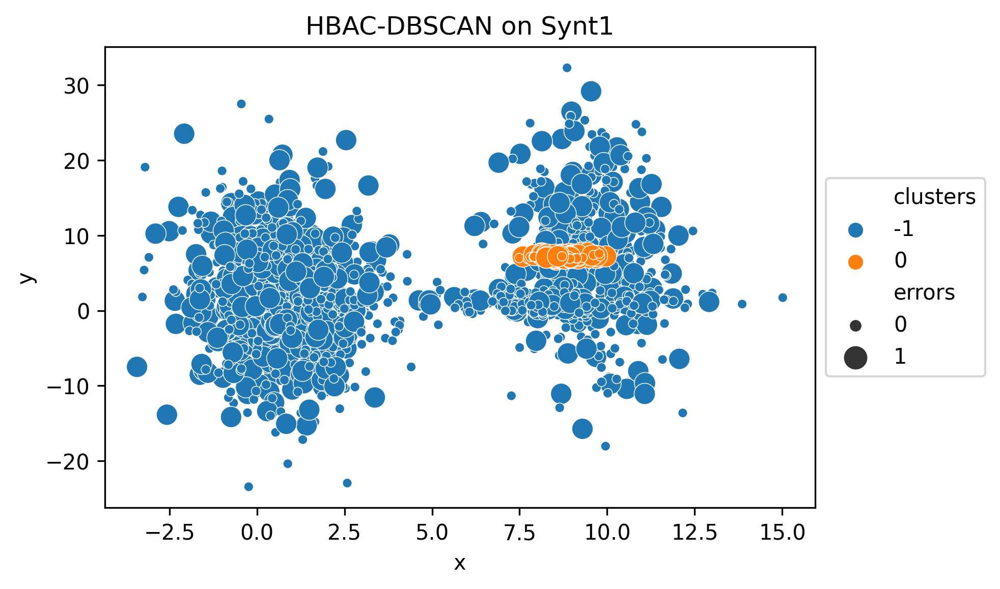

--> Cluster with the highest variance: 0
this is the current cluster:  0


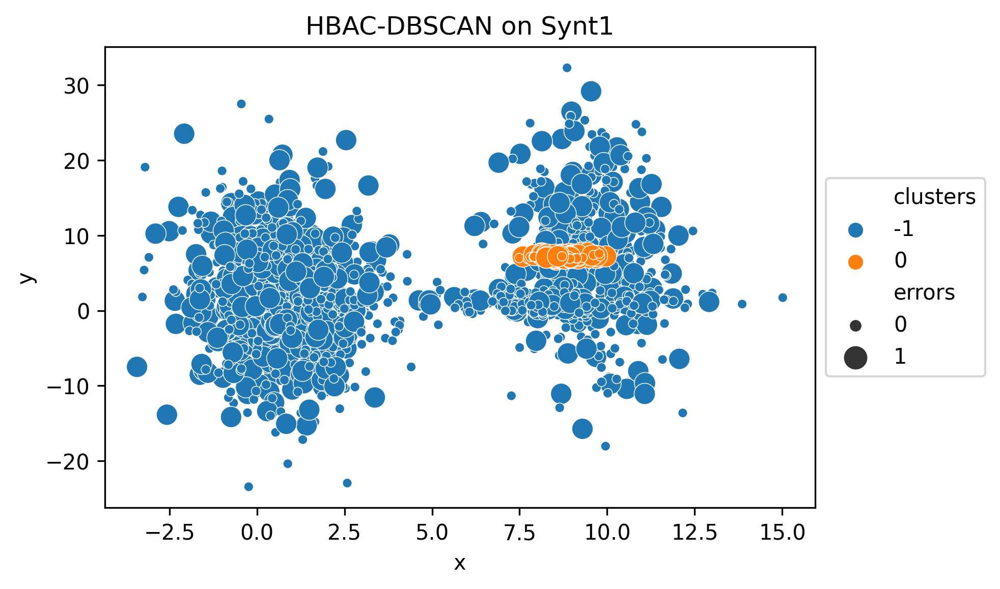

--> Cluster with the highest variance: 0
this is the current cluster:  0


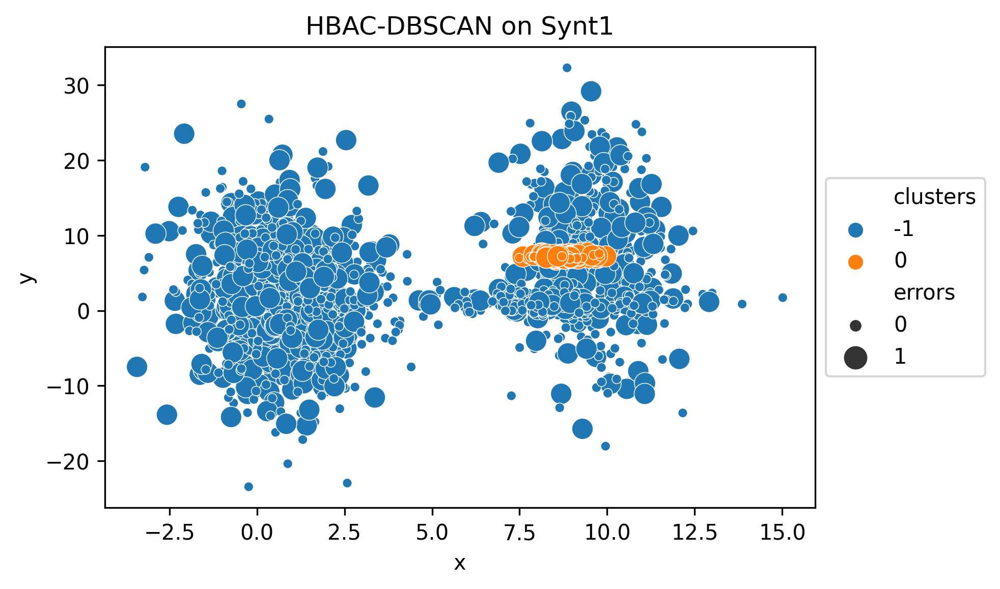

--> Cluster with the highest variance: 0
this is the current cluster:  0


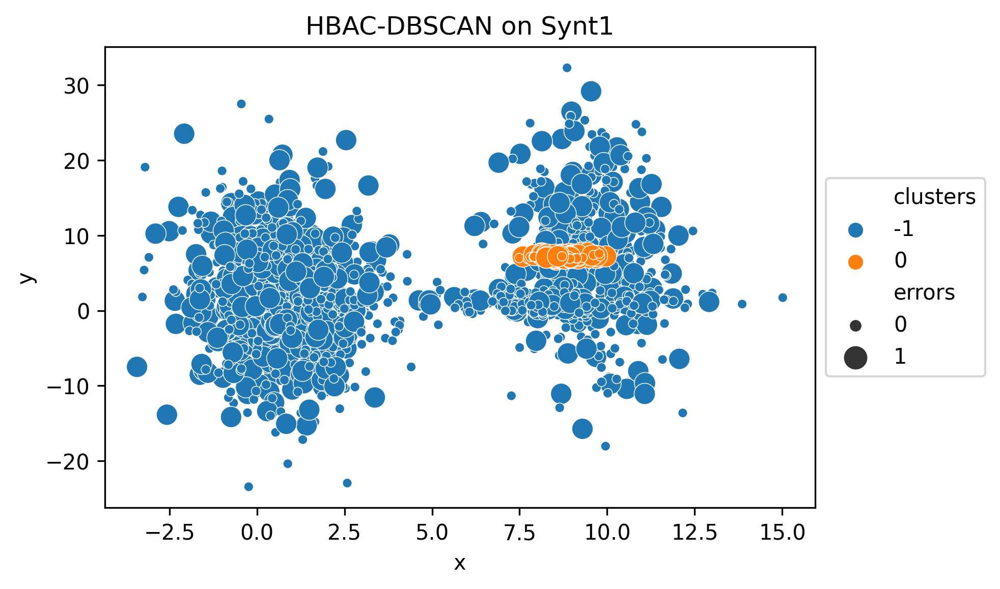

--> Cluster with the highest variance: 0
this is the current cluster:  0


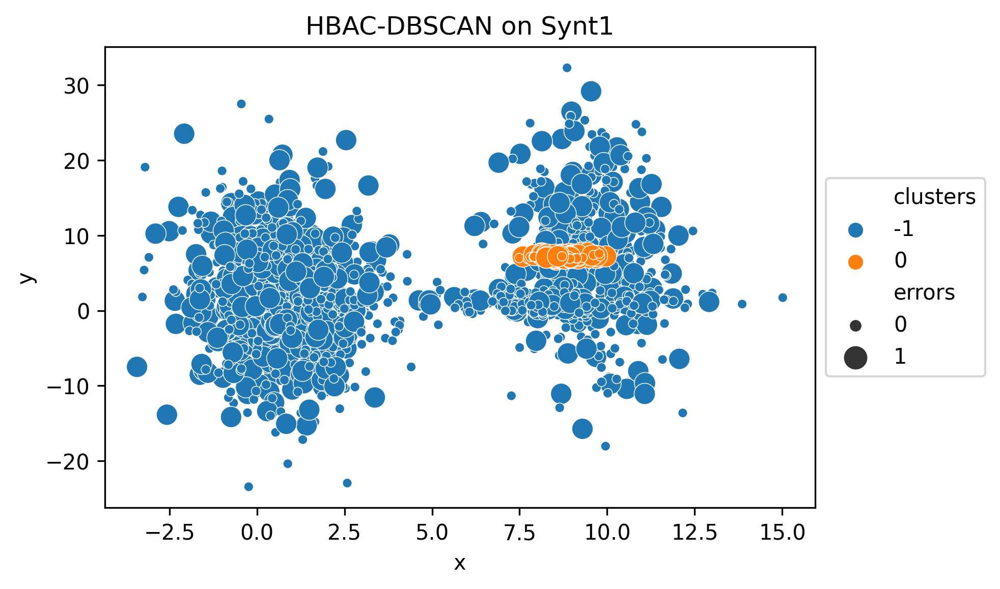

--> Cluster with the highest variance: 0
this is the current cluster:  0


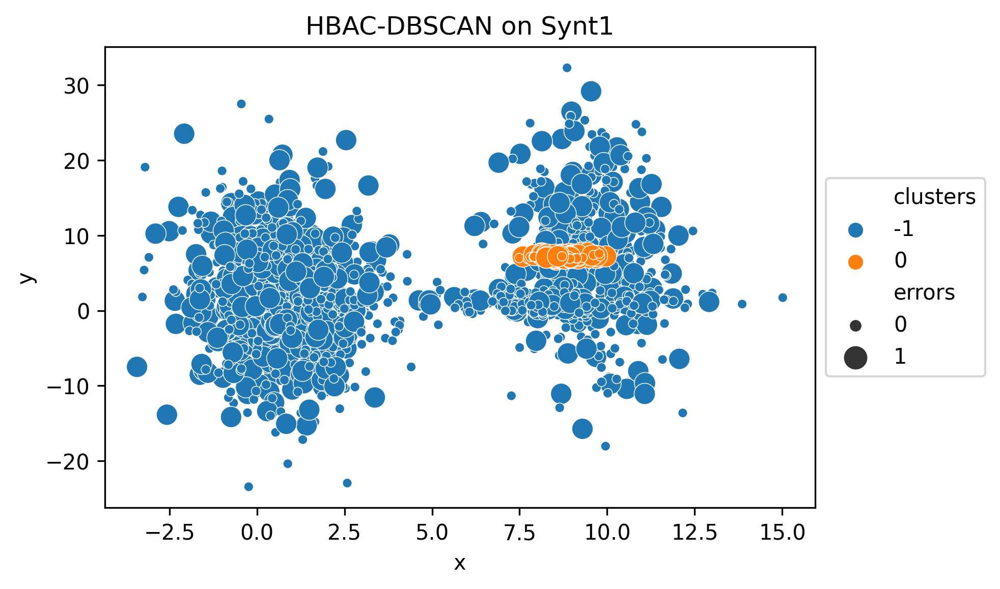

--> Cluster with the highest variance: 0
this is the current cluster:  0


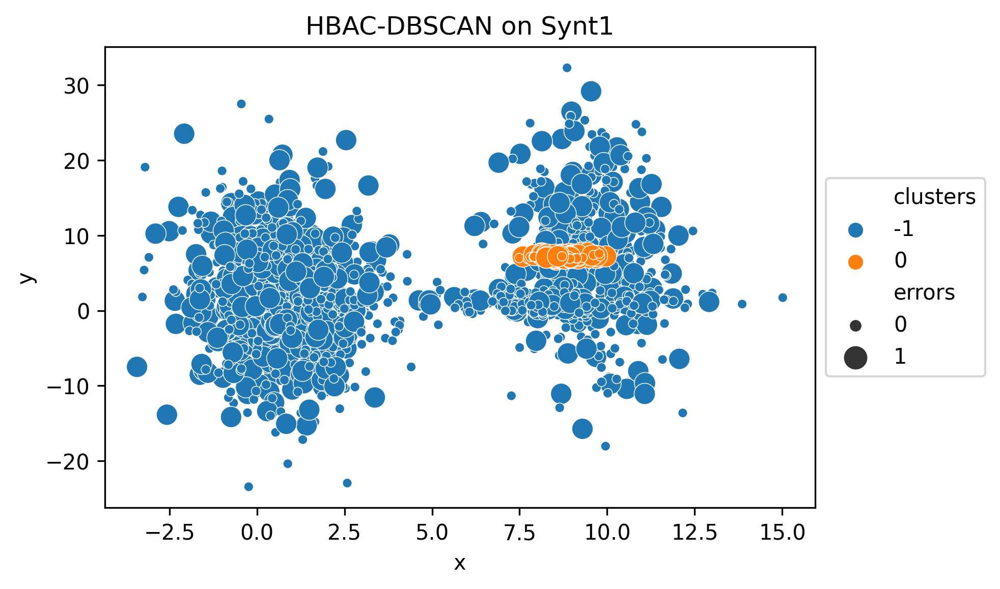

--> Cluster with the highest variance: 0
this is the current cluster:  0


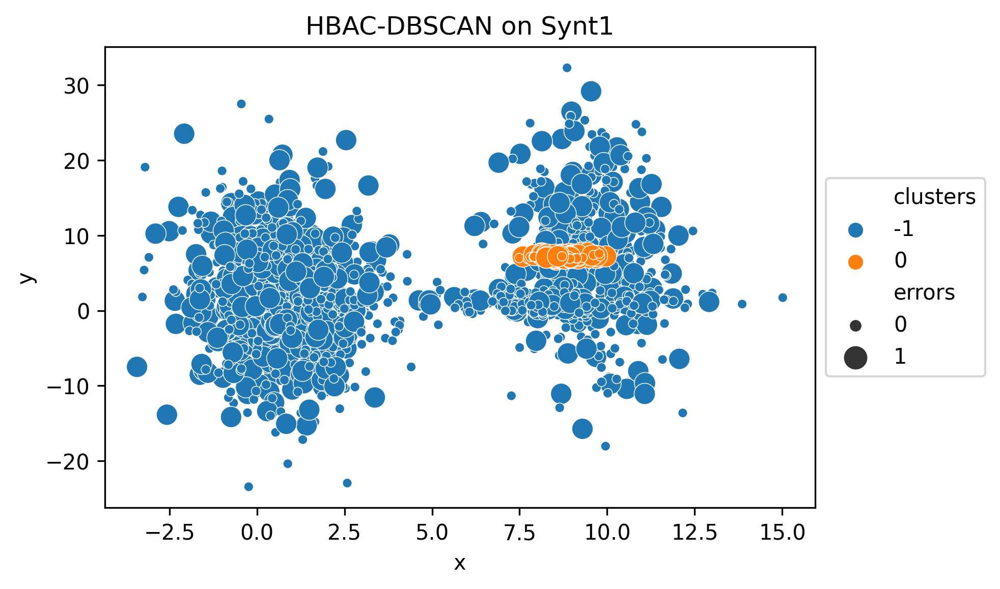

--> Cluster with the highest variance: 0
this is the current cluster:  0


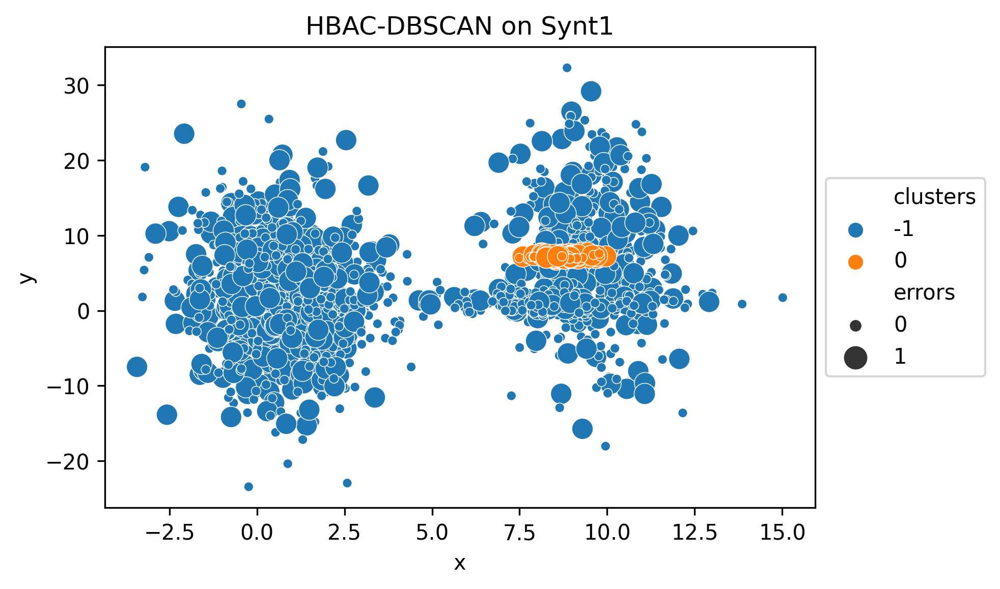

--> Cluster with the highest variance: 0
this is the current cluster:  0


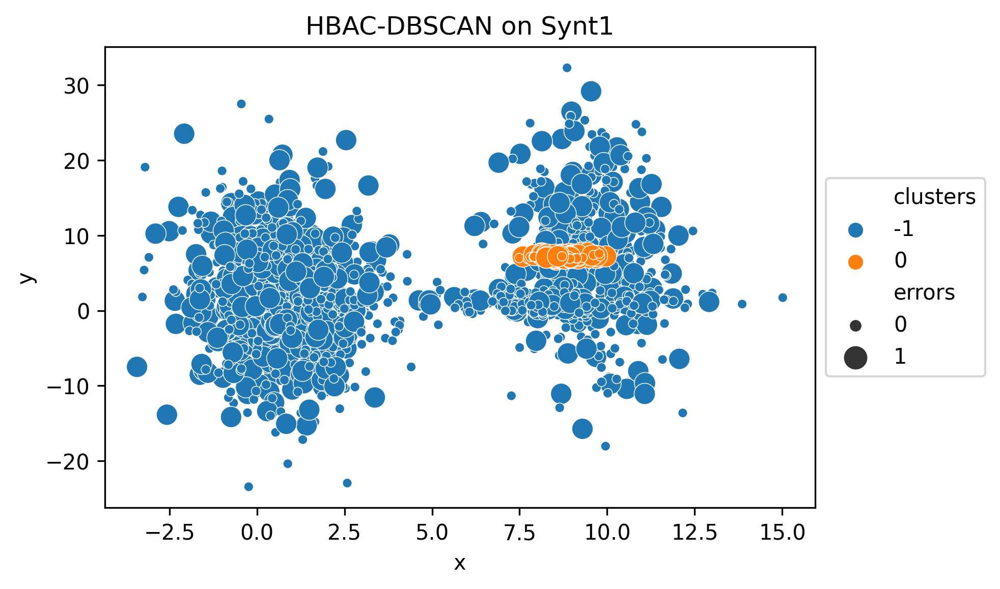

--> Cluster with the highest variance: 0
this is the current cluster:  0


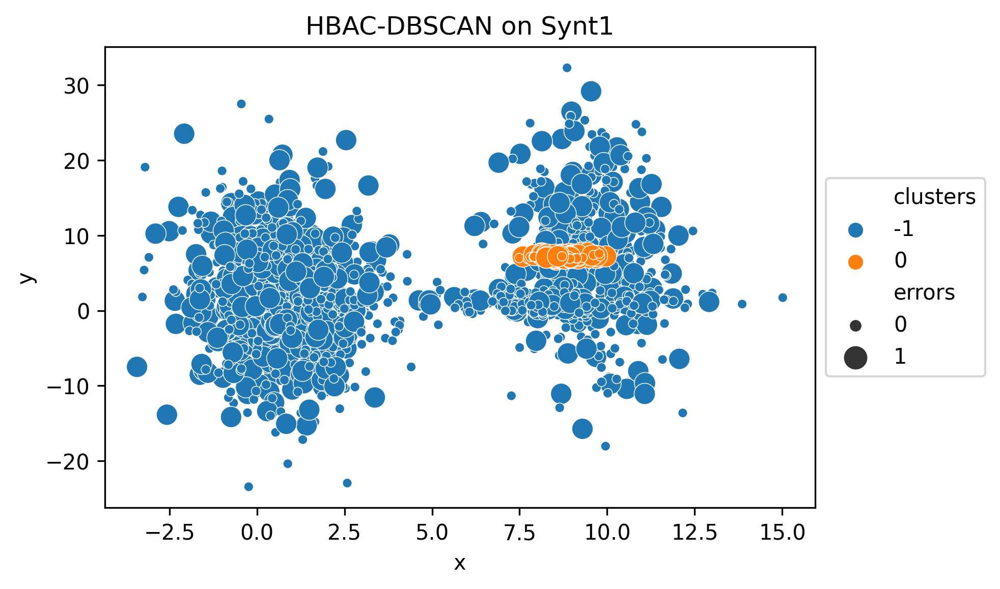

--> Cluster with the highest variance: 0
this is the current cluster:  0


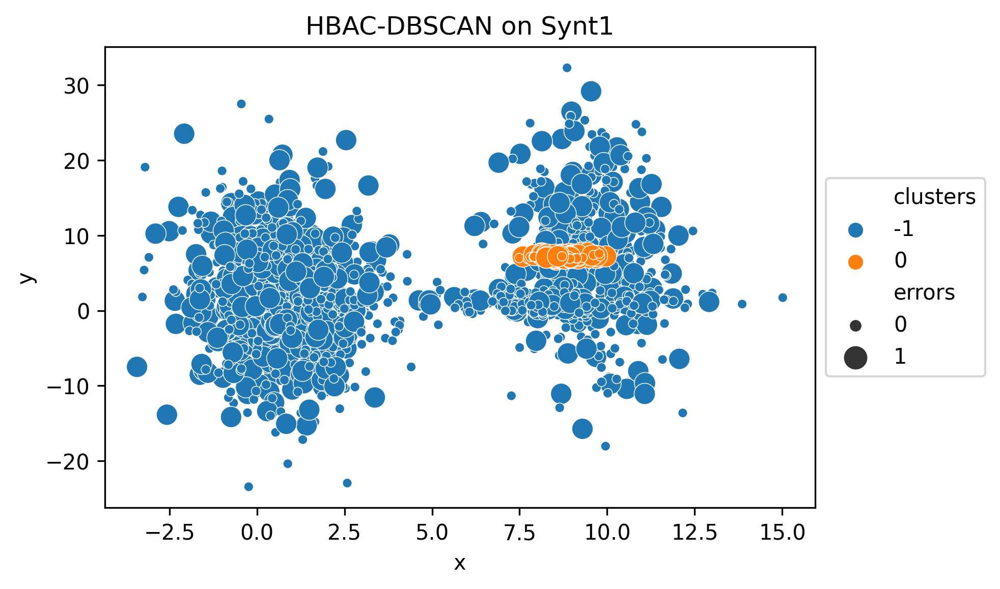

--> Cluster with the highest variance: 0
this is the current cluster:  0


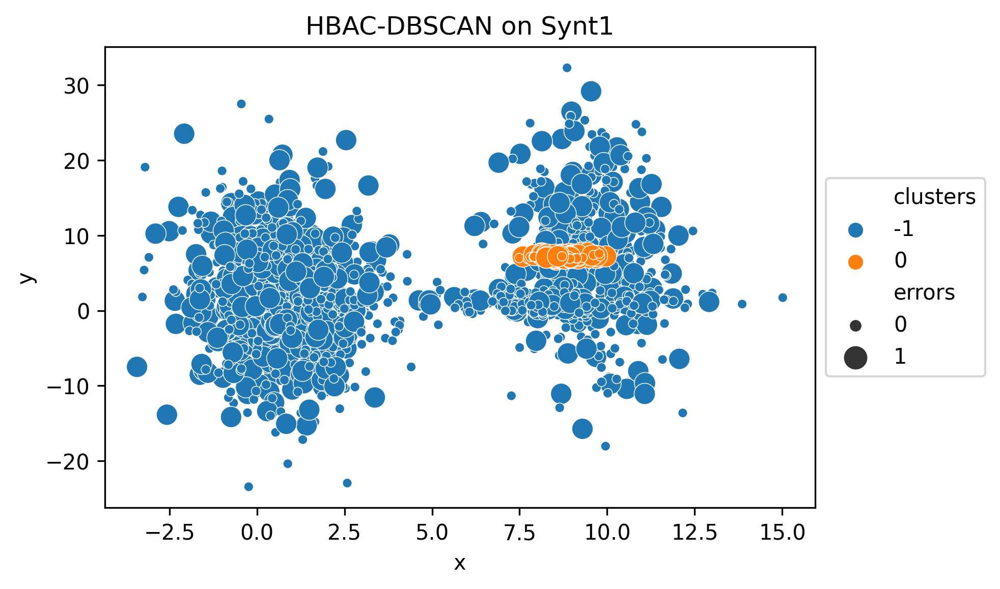

--> Cluster with the highest variance: 0
this is the current cluster:  0


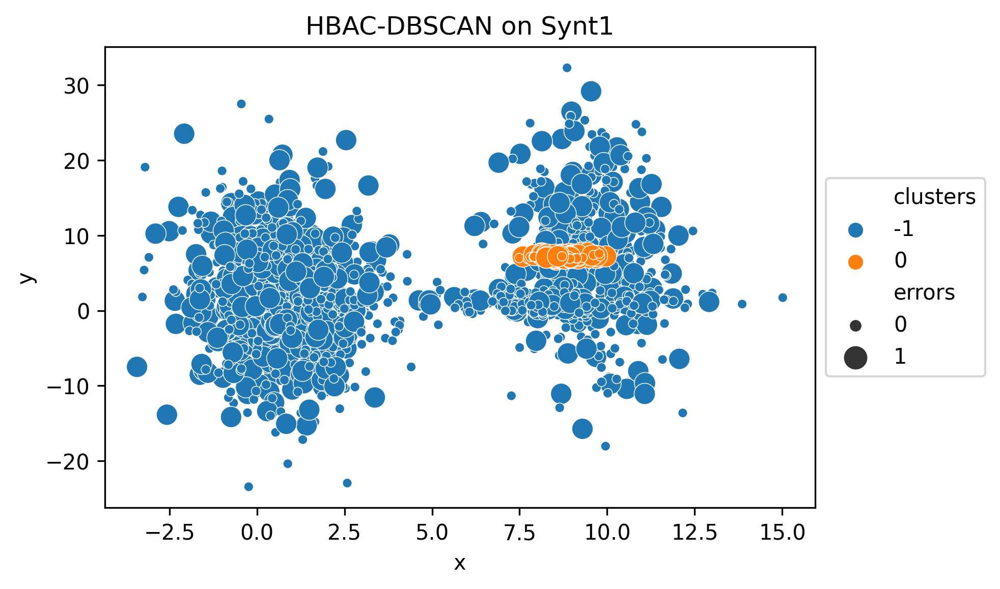

--> Cluster with the highest variance: 0
this is the current cluster:  0


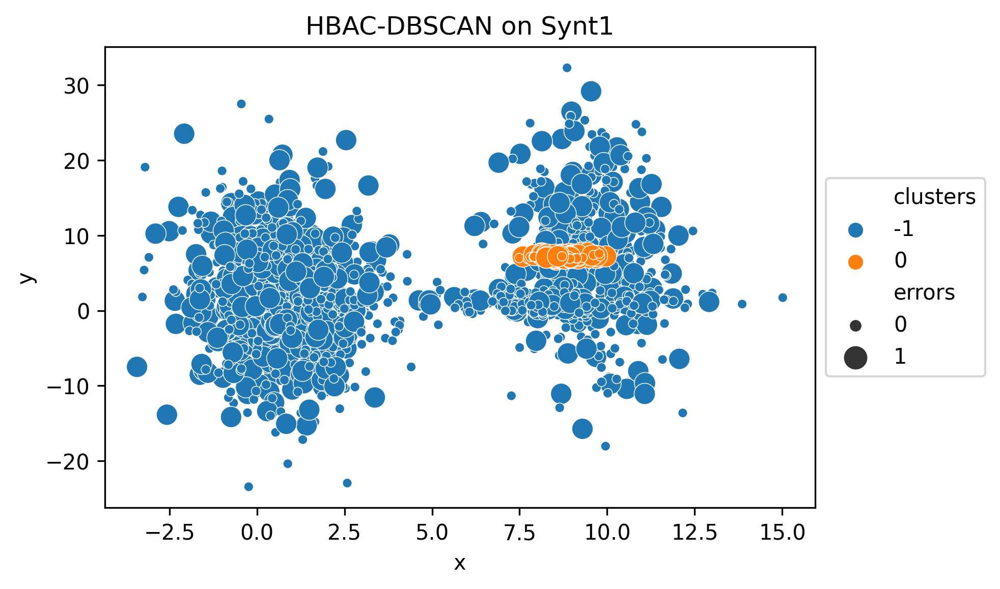

--> Cluster with the highest variance: 0
this is the current cluster:  0


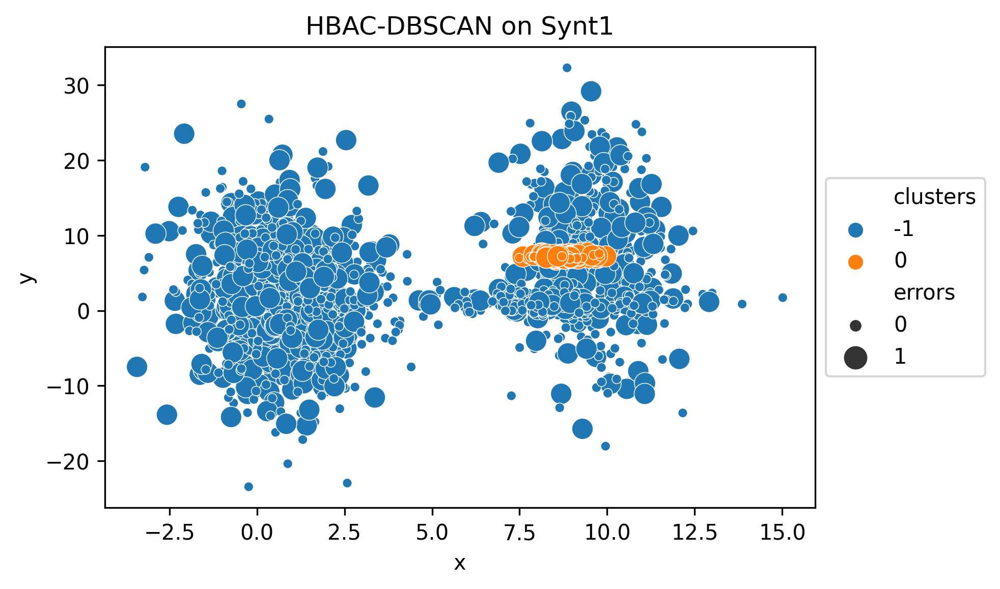

--> Cluster with the highest variance: 0
this is the current cluster:  0


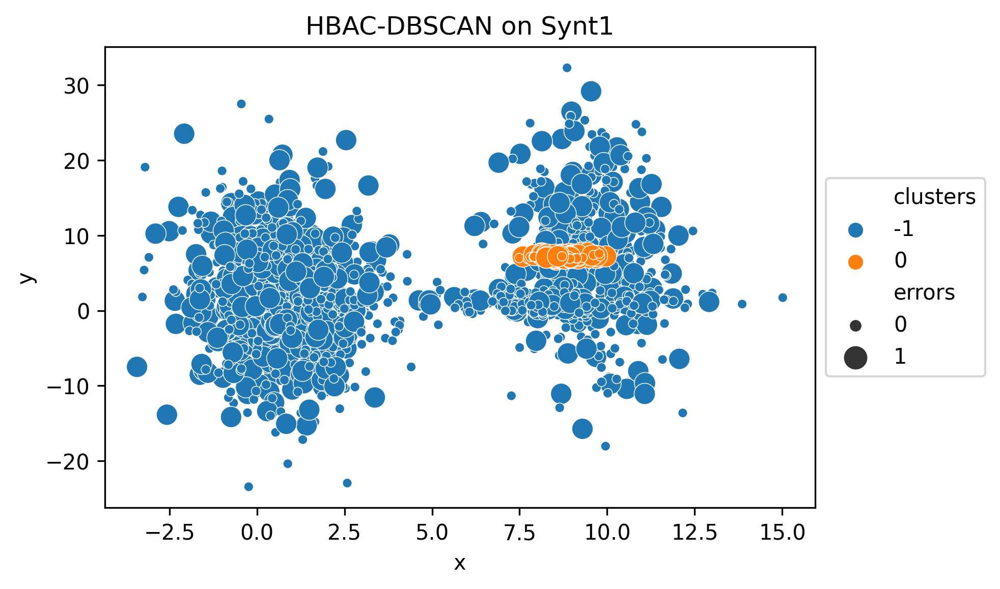

--> Cluster with the highest variance: 0
this is the current cluster:  0


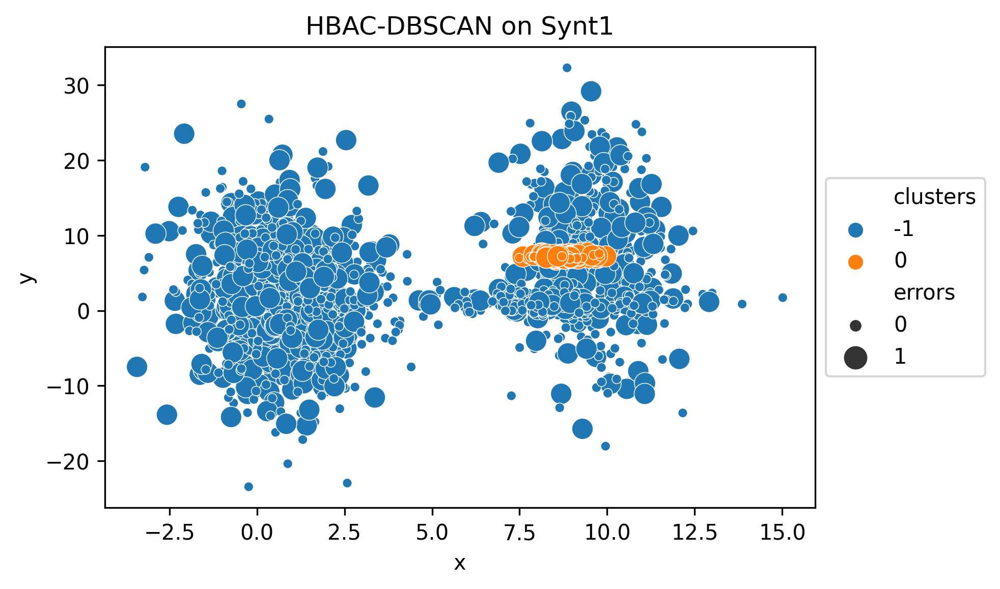

--> Cluster with the highest variance: 0
this is the current cluster:  0


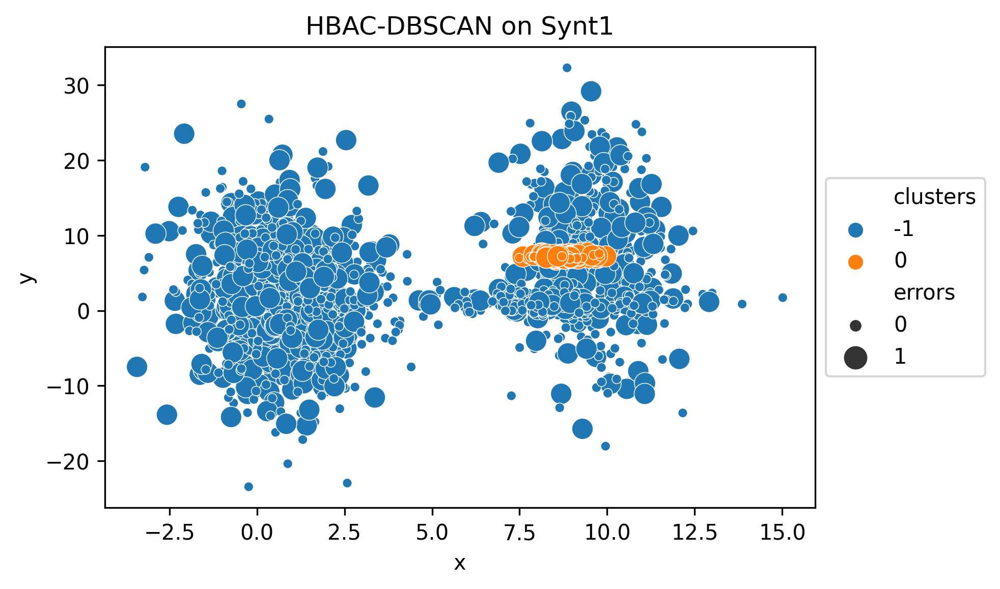

--> Cluster with the highest variance: 0
this is the current cluster:  0


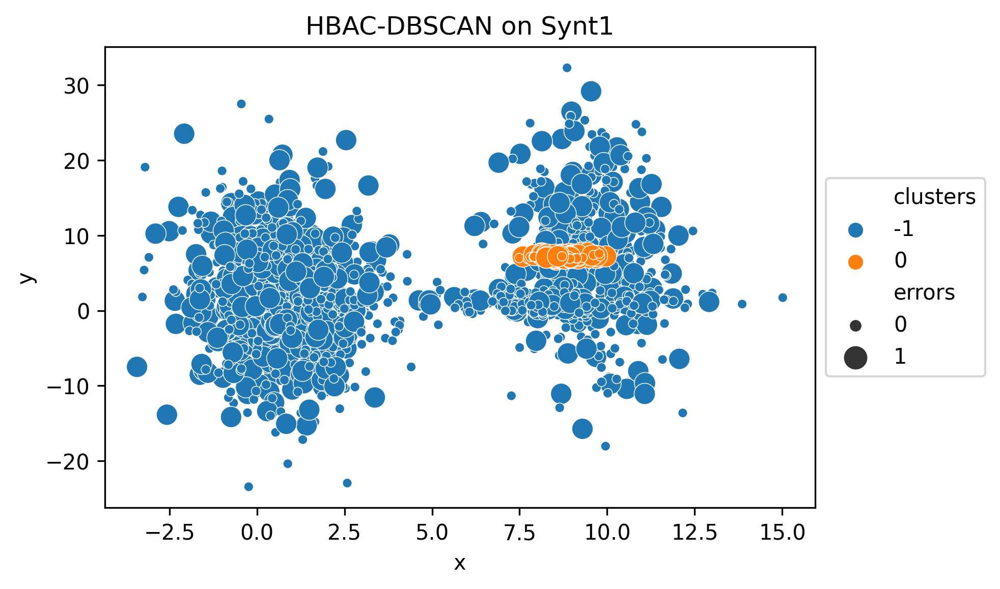

--> Cluster with the highest variance: 0
this is the current cluster:  0


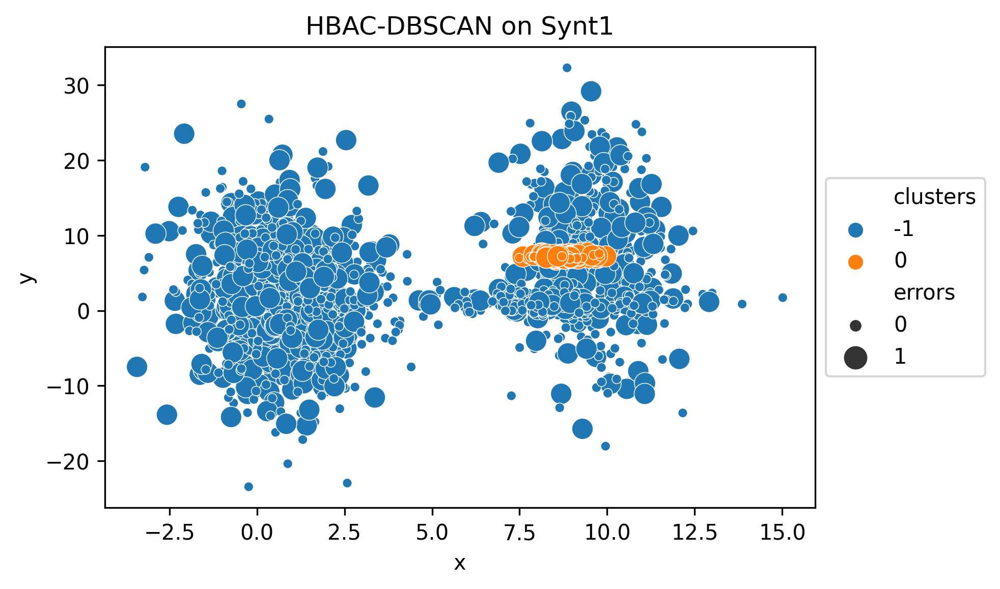

--> Cluster with the highest variance: 0
this is the current cluster:  0


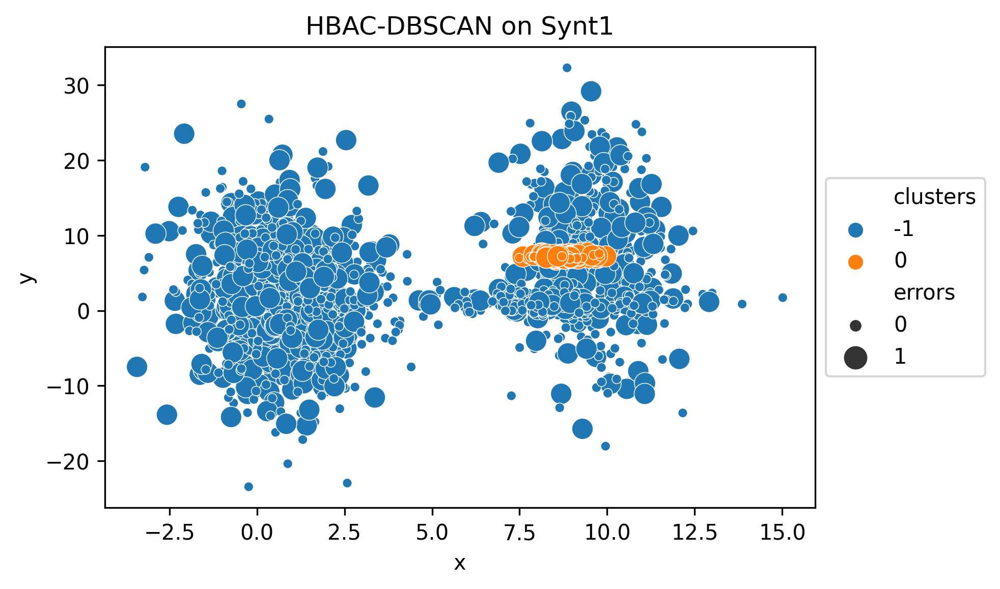

--> Cluster with the highest variance: 0
this is the current cluster:  0


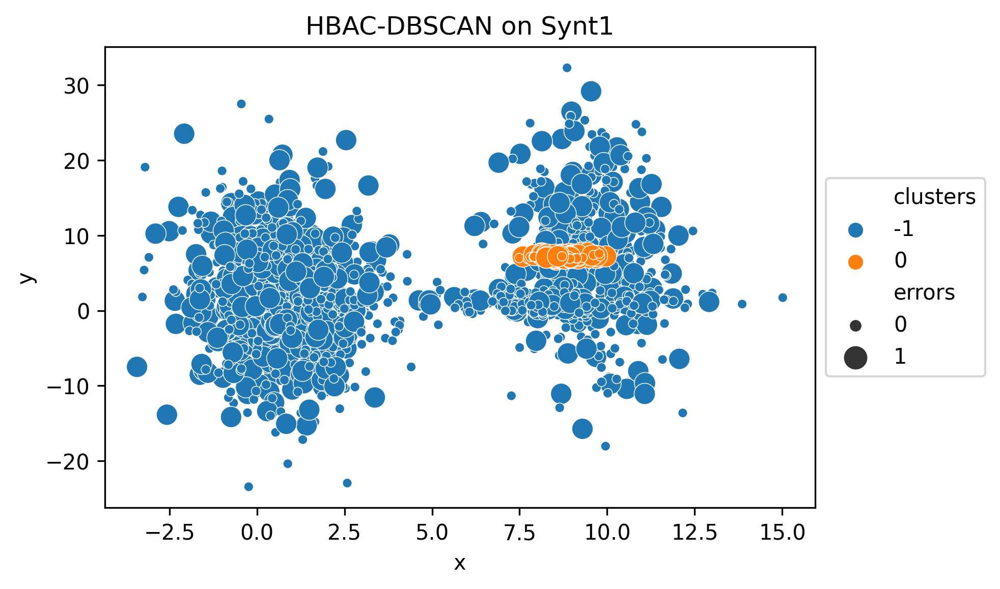

--> Cluster with the highest variance: 0
this is the current cluster:  0


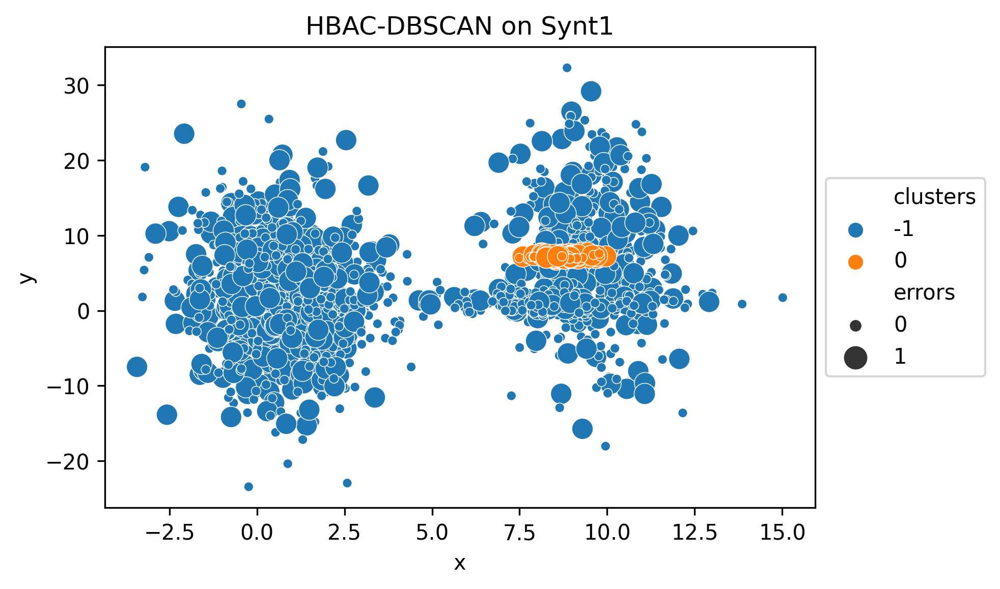

--> Cluster with the highest variance: 0
this is the current cluster:  0


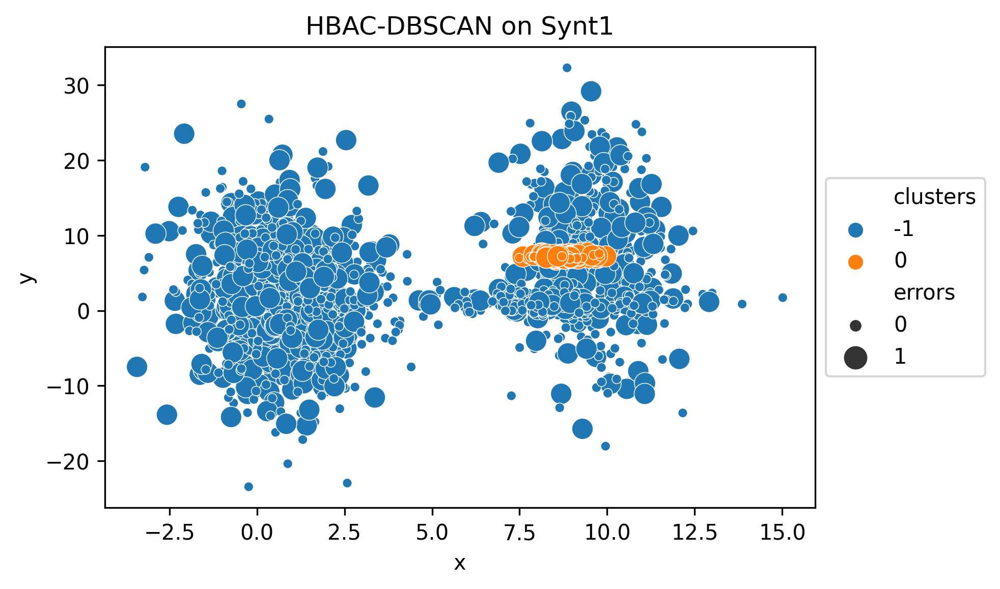

--> Cluster with the highest variance: 0
this is the current cluster:  0


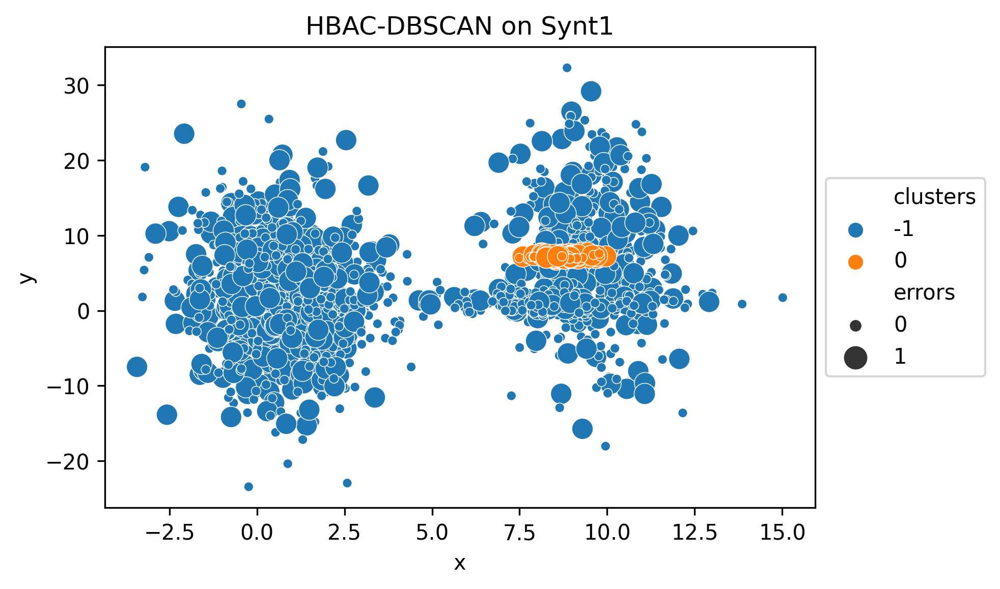

--> Cluster with the highest variance: 0
this is the current cluster:  0


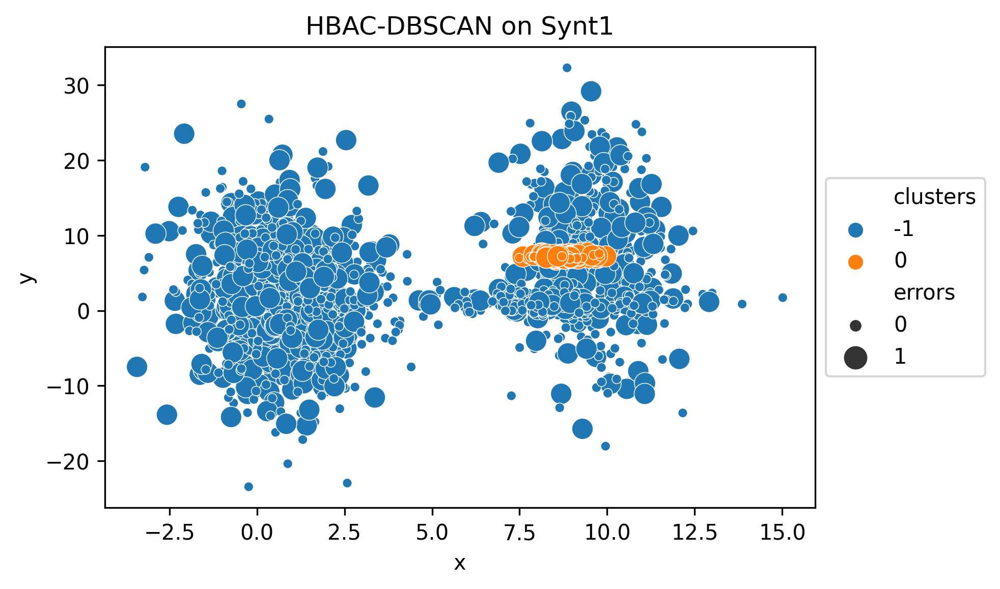

--> Cluster with the highest variance: 0
MAX_ITER
[0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664, 0.0007793236184720664]


In [158]:
#new

MAX_ITER = 30 #should be increased, but then I should increase all the max iterations for all bias-aware algorithms
# epsilon = 0.15
epsilon = 0.9
minimum_samples = round(0.03 * len(full_data)) # 2*dim
x = 0 # cluster number
initial_bias = 0
plot_clusters(full_data)
variance_list = []
minimal_splittable_cluster_size = round(0.05 * len(full_data))
minimal_acceptable_cluster_size = round(0.03 * len(full_data))
average_accuracy = accuracy(full_data)

for i in range(1, MAX_ITER):
    print('this is the current cluster: ', x)
    epsilon = epsilon + 0.001
    if len(full_data['clusters'].unique()) != 1:
        variance_list.append(calculate_variance(full_data))

    full_data['new_clusters'] = -2
    candidate_cluster = full_data.loc[full_data['clusters'] == x] 

    if len(candidate_cluster) < minimal_splittable_cluster_size:
        x = get_random_cluster(full_data['clusters'])
        continue
    
    # Apply DBSCAN
    candidate_cluster['new_clusters'] = pd.DataFrame(DBSCAN(eps=epsilon, min_samples=minimum_samples).fit_predict(candidate_cluster.drop(['clusters', 'new_clusters', 'errors'], axis=1)), index=candidate_cluster.index)

    full_data['new_clusters'] = candidate_cluster['new_clusters'].combine_first(full_data['new_clusters'])

    max_abs_bias = get_max_negative_bias(full_data) #get max abs bias
    min_new_size = get_min_cluster_size(full_data)
    
    if (max_abs_bias <= initial_bias) & (min_new_size > minimal_acceptable_cluster_size): #>
        # Add new cluster
        n_cluster = max(full_data['clusters'])
        # print(full_data['new_clusters'])
        
        first = True
        dif = 1
        for clstr in full_data['new_clusters'].unique():
            if (clstr == -1):
                full_data['clusters'][full_data['new_clusters'] == clstr] = -1
            elif (clstr == -2):
                continue
            elif first:
                full_data['clusters'][full_data['new_clusters'] == clstr] = x
                first = False
            else:
                full_data['clusters'][full_data['new_clusters'] == clstr] =  n_cluster + dif
                dif += 1

        plot_clusters(full_data)
        x = get_next_cluster(full_data)
        initial_bias = max_abs_bias
    else:
        x = get_random_cluster(full_data['clusters'])
        
print('MAX_ITER')

print(variance_list)

## 2. DBSCAN Results

In [160]:
# Goal 1: Identifying highest biased cluster
c = get_max_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_dbscan_aware = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_dbscan_aware)

0 has bias 0.027916368289447435
cluster 0 has the highest negative bias
[-1  0]
Overall accuracy: 0.6655480984340044
Highest found negative bias: 0.027916368289447435


<AxesSubplot:ylabel='variance excl errors'>

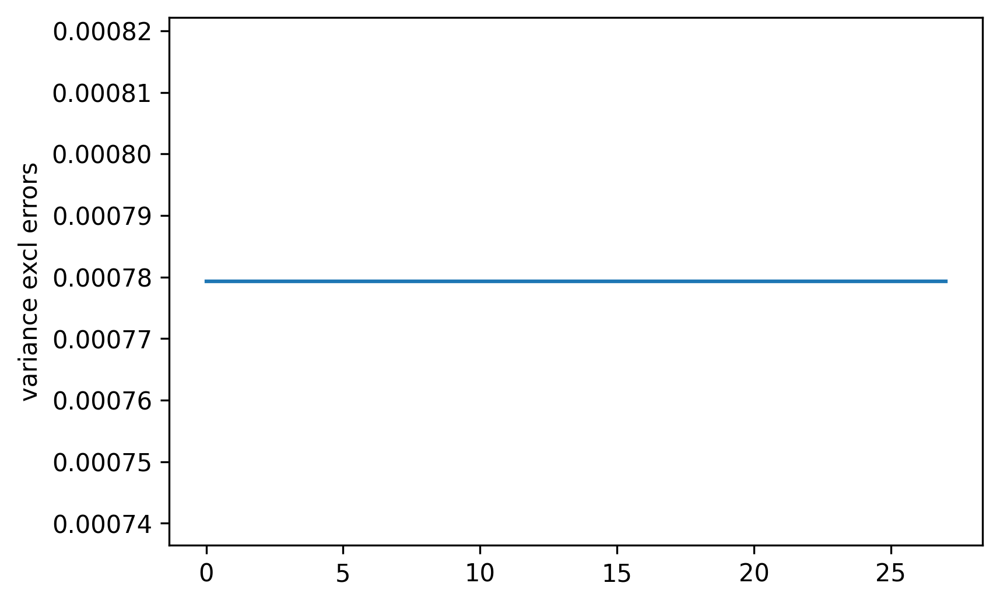

In [161]:
variance_df_dbscan = pd.DataFrame(variance_list).rename(columns={0:"variance excl errors"})
sns.lineplot(data=variance_df_dbscan, x=variance_df_dbscan.index,y="variance excl errors")

## DBSCAN Baseline

In [178]:
! pip install hdbscan

  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
    Preparing wheel metadata: started
    Preparing wheel metadata: finished with status 'done'
  Using cached Cython-0.29.23-cp39-cp39-win32.whl (1.6 MB)


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\Gebruiker\anaconda3\envs\clusterenv\python.exe' 'C:\Users\Gebruiker\anaconda3\envs\clusterenv\lib\site-packages\pip\_vendor\pep517\_in_process.py' build_wheel 'C:\Users\GEBRUI~1\AppData\Local\Temp\tmpsc60qij5'
       cwd: C:\Users\Gebruiker\AppData\Local\Temp\pip-install-x_og6or5\hdbscan_843f9279983046b8b3ab93632d1dc2f5
  Complete output (33 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build\lib.win32-3.9
  creating build\lib.win32-3.9\hdbscan
  copying hdbscan\flat.py -> build\lib.win32-3.9\hdbscan
  copying hdbscan\hdbscan_.py -> build\lib.win32-3.9\hdbscan
  copying hdbscan\plots.py -> build\lib.win32-3.9\hdbscan

Failed to build hdbscan



  copying hdbscan\prediction.py -> build\lib.win32-3.9\hdbscan
  copying hdbscan\robust_single_linkage_.py -> build\lib.win32-3.9\hdbscan
  copying hdbscan\validity.py -> build\lib.win32-3.9\hdbscan
  copying hdbscan\__init__.py -> build\lib.win32-3.9\hdbscan
  creating build\lib.win32-3.9\hdbscan\tests
  copying hdbscan\tests\test_flat.py -> build\lib.win32-3.9\hdbscan\tests
  copying hdbscan\tests\test_hdbscan.py -> build\lib.win32-3.9\hdbscan\tests
  copying hdbscan\tests\test_rsl.py -> build\lib.win32-3.9\hdbscan\tests
  copying hdbscan\tests\__init__.py -> build\lib.win32-3.9\hdbscan\tests
  running build_ext
  skipping 'hdbscan\_hdbscan_tree.c' Cython extension (up-to-date)
  skipping 'hdbscan\_hdbscan_linkage.c' Cython extension (up-to-date)
  skipping 'hdbscan\_hdbscan_boruvka.c' Cython extension (up-to-date)
  skipping 'hdbscan\_hdbscan_reachability.c' Cython extension (up-to-date)
  skipping 'hdbscan\_prediction_utils.c' Cython extension (up-to-date)
  skipping 'hdbscan\dist

In [183]:
full_data = initialize_synthetic_data(raw_data)

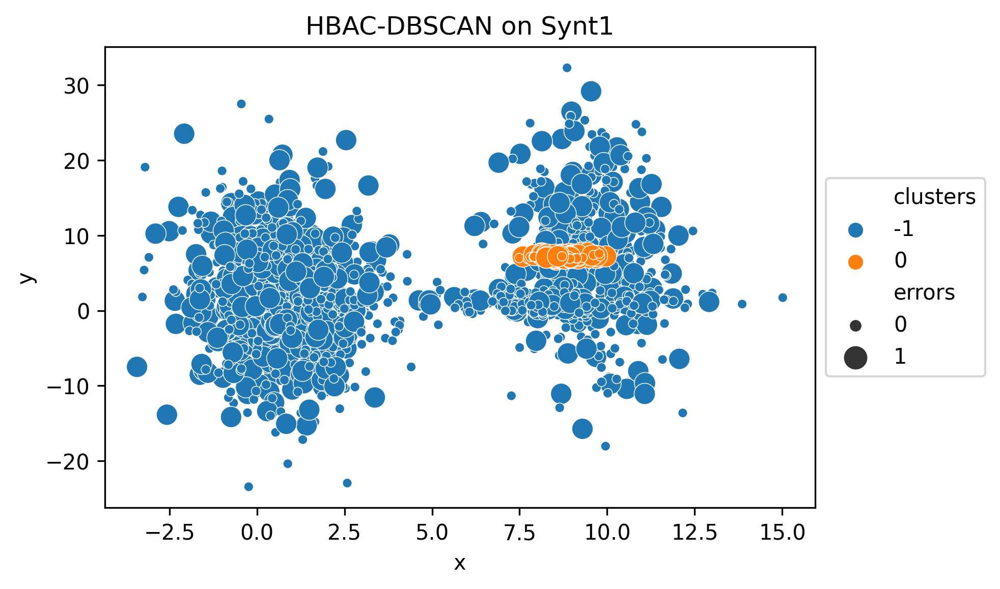

In [184]:
# bw1 = estimate_bandwidth(bandwidth_features)
epsilon = 1
minimum_samples = round(0.03 * len(full_data)) 
full_data['clusters'] = pd.DataFrame(DBSCAN(eps=epsilon, min_samples=minimum_samples).fit_predict(full_data.drop(['clusters', 'new_clusters','errors'], axis=1)), index=full_data.index)
plot_clusters(full_data)

In [185]:
# Goal 1: Identifying highest biased cluster
c = get_max_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_meanshift_aware = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_meanshift_aware)

0 has bias 0.027916368289447435
cluster 0 has the highest negative bias
[-1  0]
Overall accuracy: 0.6655480984340044
Highest found negative bias: 0.027916368289447435


## 3. Bias-Aware Mean Shift 


The estimate_bandwidth function to estimate the bandwidth parameter of Mean Shift is significantly better than manually selecting a bandwidth value.

In [36]:
from sklearn.cluster import MeanShift, estimate_bandwidth 
# full_data = initialize_dataset(raw_data)
full_data = raw_data.copy(deep=True)
full_data.head()

,1st,2nd,scaled_errors,predicted_class,true_class,errors,clusters,new_clusters
136,-1.468126,0.624496,0.0,0,0.0,0.0,0,-1
76,-1.417878,-0.950103,0.3,0,1.0,1.0,0,-1
280,-0.078468,2.895461,0.0,0,0.0,0.0,0,-1
319,-1.625901,0.254482,0.0,0,0.0,0.0,0,-1
174,-1.660360,-0.534133,0.3,0,1.0,1.0,0,-1


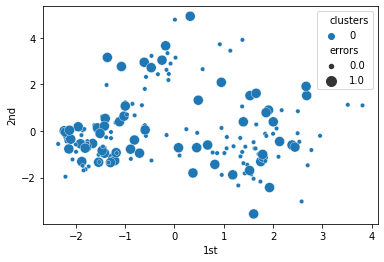

average_accuracy is:  0.6272189349112426
smallest cluster: 75
CHECK!


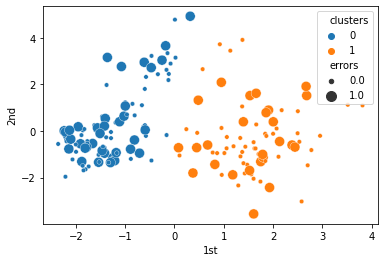

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


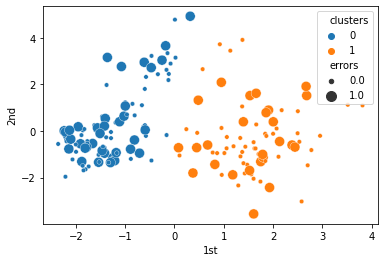

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


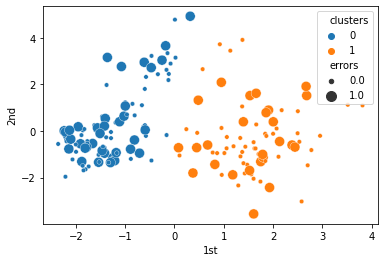

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


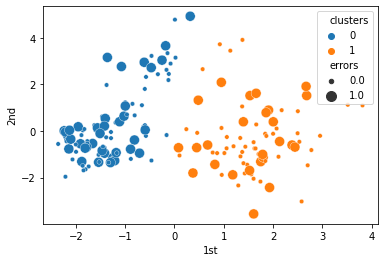

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


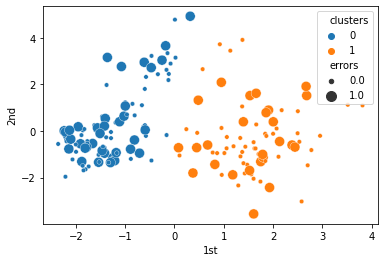

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


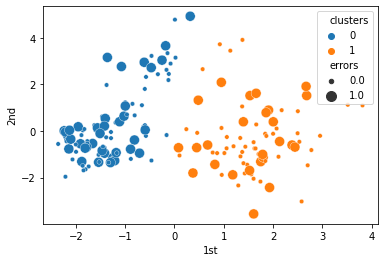

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


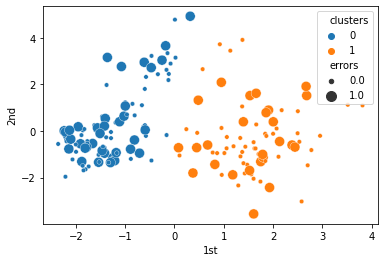

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


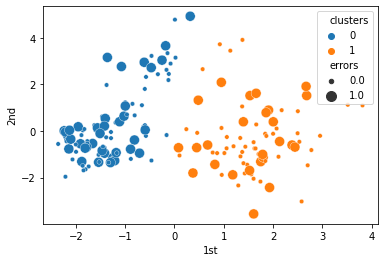

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


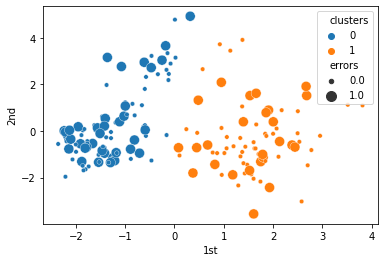

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


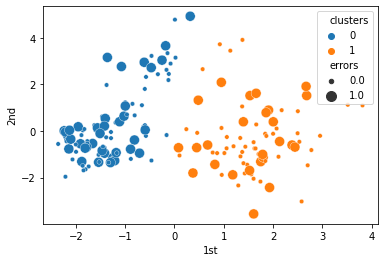

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


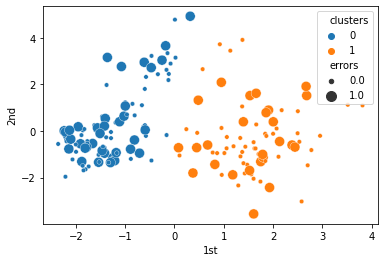

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


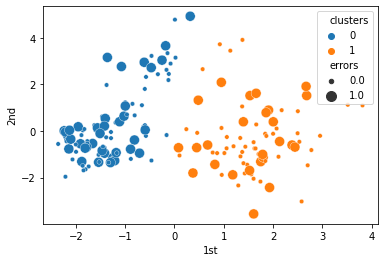

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


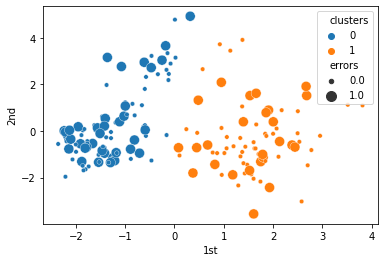

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


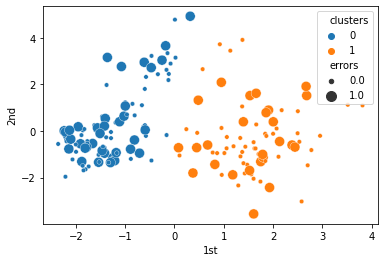

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


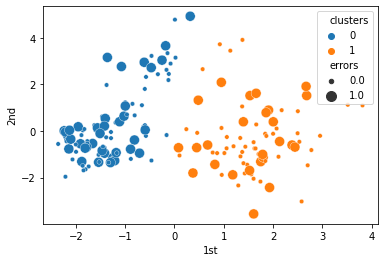

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


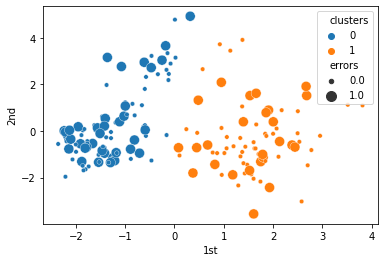

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


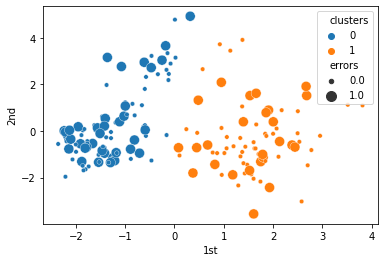

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


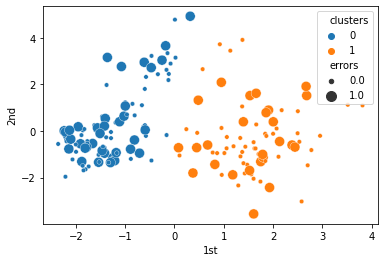

--> Cluster with the highest variance: 0
smallest cluster: 94
CHECK!


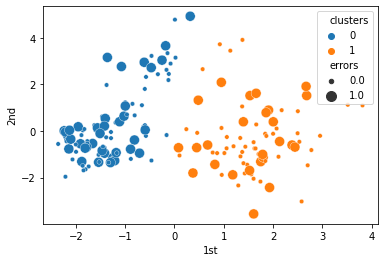

--> Cluster with the highest variance: 0
MAX_ITER
[0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568, 0.005029928072028568]


In [37]:
MAX_ITER = 20
x = 0 # cluster number
initial_bias = 0
# bw1 = 1.5
bw1 = estimate_bandwidth(full_data)
plot_clusters(full_data)
variance_list = []
average_accuracy = accuracy(full_data) 
minimal_splittable_cluster_size = 5
minimal_acceptable_cluster_size = 0
print("average_accuracy is: ", average_accuracy) 


for i in range(1, MAX_ITER):
    if i != 1:
        variance_list.append(calculate_variance(full_data)) 
    full_data['new_clusters'] = -1
    candidate_cluster = full_data.loc[full_data['clusters'] == x] 

    if len(candidate_cluster) < minimal_splittable_cluster_size:
        x = get_random_cluster(full_data['clusters'])
        continue
    
    # Apply MeanShift
    candidate_cluster['new_clusters'] = pd.DataFrame(MeanShift(bandwidth=bw1).fit_predict(candidate_cluster.drop(['clusters', 'new_clusters', 'predicted_class',                                                    'true_class', 'errors'], axis=1)), index=candidate_cluster.index)

    full_data['new_clusters'] = candidate_cluster['new_clusters'].combine_first(full_data['new_clusters']) 

    max_abs_bias = get_max_negative_bias(full_data) #get max abs bias
    min_new_size = get_min_cluster_size(full_data)
    print("smallest cluster:",min_new_size)
    if (max_abs_bias <= initial_bias) & (min_new_size > minimal_acceptable_cluster_size): 
        print("CHECK!")
        # Add new cluster
        n_cluster = max(full_data['clusters'])
        full_data['clusters'][full_data['new_clusters'] == 1] =  n_cluster + 1
        
        plot_clusters(full_data)
        x = get_next_cluster(full_data)
        initial_bias = max_abs_bias
    else:
        x = get_random_cluster(full_data['clusters'])
        
print('MAX_ITER')

print(variance_list)

## 3. Mean-Shift Results

In [38]:
# Goal 1: Identifying highest biased cluster
c = get_max_abs_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_meanshift_aware = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_meanshift_aware)

0 has bias -0.07092198581560283
1 has bias 0.07092198581560283
cluster 0 has the highest negative bias
[0 1]
Overall accuracy: 0.6272189349112426
Highest found negative bias: -0.07092198581560283


<AxesSubplot:ylabel='variance incl errors'>

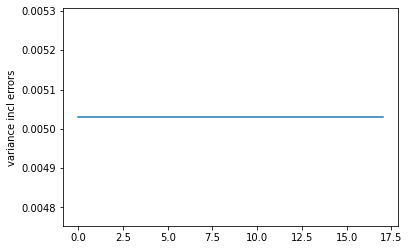

In [39]:
variance_df = pd.DataFrame(variance_list).rename(columns={0:"variance incl errors"})
sns.lineplot(data=variance_df, x=variance_df.index,y="variance incl errors")

## Baseline Mean Shift

In [40]:
# full_data = initialize_dataset(raw_data)

full_data = raw_data.copy(deep=True)
full_data.head()

,1st,2nd,scaled_errors,predicted_class,true_class,errors,clusters,new_clusters
136,-1.468126,0.624496,0.0,0,0.0,0.0,0,-1
76,-1.417878,-0.950103,0.3,0,1.0,1.0,0,-1
280,-0.078468,2.895461,0.0,0,0.0,0.0,0,-1
319,-1.625901,0.254482,0.0,0,0.0,0.0,0,-1
174,-1.660360,-0.534133,0.3,0,1.0,1.0,0,-1


In [41]:
bw1 = estimate_bandwidth(full_data)

full_data['clusters'] = pd.DataFrame(MeanShift(bandwidth=bw1).fit_predict(full_data.drop(['clusters', 'new_clusters', 'predicted_class',                                                    'true_class', 'errors'], axis=1)), index=full_data.index)

In [42]:
# Goal 1: Identifying highest biased cluster
c = get_max_abs_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_baselinemeanshift = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_baselinemeanshift)

0 has bias -0.07092198581560283
1 has bias 0.07092198581560283
cluster 0 has the highest negative bias
[0 1]
Overall accuracy: 0.6272189349112426
Highest found negative bias: -0.07092198581560283


## Goal 1: Comparing Bias-Aware KMeans/DBSCAN/MeanShift with finding the highest negatively biased cluster

<BarContainer object of 5 artists>

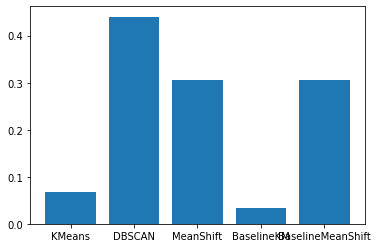

In [33]:
results_array = []

# the minus is to make the values positive, as that makes it easier to find the highest negative biased cluster
results_array.append(-most_biased_cluster_kmeans_aware)
results_array.append(-most_biased_cluster_dbscan_aware)
results_array.append(-most_biased_cluster_meanshift_aware)
results_array.append(-most_biased_cluster_baselinekm)
results_array.append(-most_biased_cluster_baselinemeanshift)


plt.bar(['KMeans', 'DBSCAN', 'MeanShift', 'BaselineKM', 'BaselineMeanShift'], results_array)
# todo: add baselines


In [47]:
full_data = raw_data.copy(deep=True)
full_data.head()

# full_data = initialize_dataset(raw_data)

,1st,2nd,scaled_errors,predicted_class,true_class,errors,clusters,new_clusters
136,-1.468126,0.624496,0.0,0,0.0,0.0,0,-1
76,-1.417878,-0.950103,0.3,0,1.0,1.0,0,-1
280,-0.078468,2.895461,0.0,0,0.0,0.0,0,-1
319,-1.625901,0.254482,0.0,0,0.0,0.0,0,-1
174,-1.660360,-0.534133,0.3,0,1.0,1.0,0,-1


One cluster left on iteration  2
With epsilon 6.8
[]


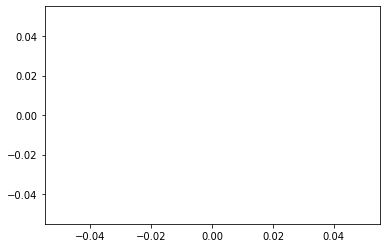

In [48]:
var_list = []
epsilon = 7
minimum_samples = 3
features_i = features.copy(deep=True)
features_i["errors"] = errors

for n in range(2, 58):
    model = DBSCAN(eps=epsilon, min_samples=minimum_samples).fit_predict(features_i)
    features_i['cluster_results'] = pd.DataFrame(model, index=features_i.index)

    neg_bias_list = []
    epsilon = epsilon-0.2
    if  len(features_i["cluster_results"].unique()) == 1:
        print("One cluster left on iteration ", n)
        print("With epsilon", epsilon)
        break
    for i in features_i["cluster_results"].unique():
        print(features_i["cluster_results"].unique())
        #print('features_i', features_i)
        neg_bias_list.append(bias_acc(features_i, i,"cluster_results"))
    var_list.append(np.var(neg_bias_list))
print(var_list)

plt.plot(var_list)

## MeanShift without recursivity

In [36]:
full_data = initialize_dataset(raw_data)

In [37]:
bw1 = estimate_bandwidth(full_data)

full_data['clusters'] = pd.DataFrame(MeanShift(bandwidth=bw1).fit_predict(full_data.drop(['clusters', 'new_clusters', 'predicted_class',                                                    'true_class', 'errors'], axis=1)), index=full_data.index)

In [38]:
# Goal 1: Identifying highest biased cluster
c = get_max_abs_bias_cluster(full_data)
print(f"cluster {c} has the highest negative bias")
print(full_data['clusters'].unique())
highest_biased_cluster = full_data[full_data['clusters']==c]
len(highest_biased_cluster)

accuracy_full_data = accuracy(full_data)
print('Overall accuracy:', accuracy_full_data)

most_biased_cluster_baselinemeanshift = bias_acc(full_data, c, 'clusters')

full_data[full_data['clusters']==c]
print('Highest found negative bias:', most_biased_cluster_baselinemeanshift)

0 has bias 0.08745684695051792
1 has bias -0.3047034764826176
3 has bias 0.375
4 has bias 0.375
2 has bias -0.12874251497005984
5 has bias 0.375
cluster 1 has the highest negative bias
[0 1 3 4 2 5]
Overall accuracy: 0.6272189349112426
Highest found negative bias: -0.3047034764826176


In [ ]:
var_list = []

# experimenting with the bandwidth parameter
bw1 = estimate_bandwidth(features_i)
bw2 = None
features_i = features.copy(deep=True)
features_i["errors"] = errors

for n in range(2, 58):
    model = MeanShift(bandwidth=bw1).fit_predict(features_i)
    features_i['cluster_results'] = pd.DataFrame(model, index=features_i.index)
    #features['cluster_results'] = pd.DataFrame(DBSCAN.predict(features_i), index=features.index)
    neg_bias_list = []
    if  len(features_i["cluster_results"].unique()) == 1:
        # print("One cluster left on iteration ", n)
        break
    for i in features_i["cluster_results"].unique():
        # print(features_i["cluster_results"].unique())
        #print('features_i', features_i)
        neg_bias_list.append(bias_acc(features_i, i,"cluster_results"))
    var_list.append(np.var(neg_bias_list))
# print(var_list)



In [97]:
def dbscan(X, eps, min_samples):
    ss = StandardScaler()
    X = ss.fit_transform(X)
    db = DBSCAN(eps=eps, min_samples=min_samples)
    db.fit(X)
    y_pred = db.fit_predict(X)
    plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired', s=1.1)
    plt.title("DBSCAN")

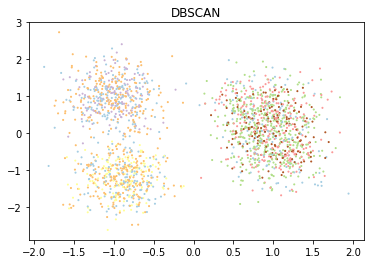

In [101]:
dbscan(synthetic, 1, 100)

In [94]:
def kmeans(X, n_clusters):
    ss = StandardScaler()
    X = ss.fit_transform(X)
    km = KMeans(n_clusters=n_clusters)
    km.fit(X)
    y_pred = km.predict(X)
    plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired', s=0.9)
    plt.title("K-means")